# Session (475165_f1_stage2_day7)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f1_stage2_day7" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f1"
day = "day7"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35993, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


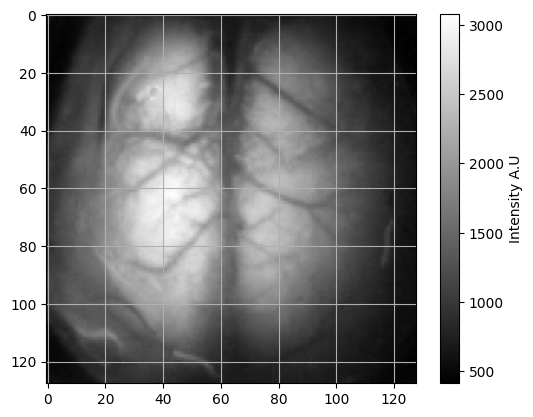

frame number 6000 plotted


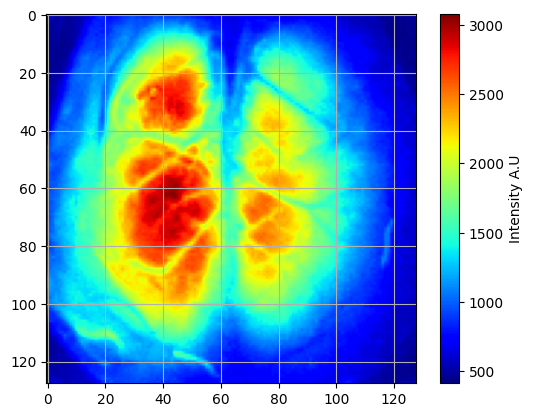

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 452.236083984375 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 508.7655944824219


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 98
Number of double_flash pairs: 49
Number of single_flash: 42
Number of total flashes: 140


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/140 [00:00<?, ?it/s]

  1%|▌                                                                                 | 1/140 [00:01<03:00,  1.30s/it]

  1%|█▏                                                                                | 2/140 [00:02<02:56,  1.28s/it]

  2%|█▊                                                                                | 3/140 [00:03<02:56,  1.29s/it]

  3%|██▎                                                                               | 4/140 [00:05<02:57,  1.31s/it]

  4%|██▉                                                                               | 5/140 [00:06<03:03,  1.36s/it]

  4%|███▌                                                                              | 6/140 [00:07<02:57,  1.32s/it]

  5%|████                                                                              | 7/140 [00:09<02:59,  1.35s/it]

  6%|████▋                                                                             | 8/140 [00:10<02:56,  1.33s/it]

  6%|█████▎                                                                            | 9/140 [00:11<02:52,  1.32s/it]

  7%|█████▊                                                                           | 10/140 [00:13<02:52,  1.33s/it]

  8%|██████▎                                                                          | 11/140 [00:14<02:49,  1.31s/it]

  9%|██████▉                                                                          | 12/140 [00:15<02:47,  1.31s/it]

  9%|███████▌                                                                         | 13/140 [00:17<02:46,  1.31s/it]

 10%|████████                                                                         | 14/140 [00:18<02:46,  1.32s/it]

 11%|████████▋                                                                        | 15/140 [00:19<02:49,  1.36s/it]

 11%|█████████▎                                                                       | 16/140 [00:21<03:01,  1.46s/it]

 12%|█████████▊                                                                       | 17/140 [00:22<02:49,  1.38s/it]

 13%|██████████▍                                                                      | 18/140 [00:23<02:39,  1.31s/it]

 14%|██████████▉                                                                      | 19/140 [00:25<02:34,  1.28s/it]

 14%|███████████▌                                                                     | 20/140 [00:26<02:35,  1.30s/it]

 15%|████████████▏                                                                    | 21/140 [00:27<02:35,  1.30s/it]

 16%|████████████▋                                                                    | 22/140 [00:29<02:33,  1.30s/it]

 16%|█████████████▎                                                                   | 23/140 [00:30<02:35,  1.33s/it]

 17%|█████████████▉                                                                   | 24/140 [00:31<02:28,  1.28s/it]

 18%|██████████████▍                                                                  | 25/140 [00:32<02:26,  1.27s/it]

 19%|███████████████                                                                  | 26/140 [00:34<02:29,  1.31s/it]

 19%|███████████████▌                                                                 | 27/140 [00:35<02:27,  1.31s/it]

 20%|████████████████▏                                                                | 28/140 [00:36<02:23,  1.28s/it]

 21%|████████████████▊                                                                | 29/140 [00:38<02:23,  1.29s/it]

 21%|█████████████████▎                                                               | 30/140 [00:39<02:19,  1.27s/it]

 22%|█████████████████▉                                                               | 31/140 [00:40<02:18,  1.27s/it]

 23%|██████████████████▌                                                              | 32/140 [00:41<02:15,  1.25s/it]

 24%|███████████████████                                                              | 33/140 [00:43<02:15,  1.27s/it]

 24%|███████████████████▋                                                             | 34/140 [00:44<02:17,  1.29s/it]

 25%|████████████████████▎                                                            | 35/140 [00:45<02:15,  1.29s/it]

 26%|████████████████████▊                                                            | 36/140 [00:47<02:12,  1.27s/it]

 26%|█████████████████████▍                                                           | 37/140 [00:48<02:13,  1.29s/it]

 27%|█████████████████████▉                                                           | 38/140 [00:49<02:18,  1.35s/it]

 28%|██████████████████████▌                                                          | 39/140 [00:51<02:12,  1.32s/it]

 29%|███████████████████████▏                                                         | 40/140 [00:52<02:14,  1.34s/it]

 29%|███████████████████████▋                                                         | 41/140 [00:53<02:09,  1.31s/it]

 30%|████████████████████████▎                                                        | 42/140 [00:55<02:09,  1.32s/it]

 31%|████████████████████████▉                                                        | 43/140 [00:56<02:10,  1.35s/it]

 31%|█████████████████████████▍                                                       | 44/140 [00:57<02:08,  1.34s/it]

 32%|██████████████████████████                                                       | 45/140 [00:59<02:06,  1.33s/it]

 33%|██████████████████████████▌                                                      | 46/140 [01:00<02:04,  1.33s/it]

 34%|███████████████████████████▏                                                     | 47/140 [01:01<02:04,  1.34s/it]

 34%|███████████████████████████▊                                                     | 48/140 [01:03<02:07,  1.39s/it]

 35%|████████████████████████████▎                                                    | 49/140 [01:04<02:01,  1.34s/it]

 36%|████████████████████████████▉                                                    | 50/140 [01:05<01:58,  1.31s/it]

 36%|█████████████████████████████▌                                                   | 51/140 [01:07<01:59,  1.34s/it]

 37%|██████████████████████████████                                                   | 52/140 [01:08<01:53,  1.30s/it]

 38%|██████████████████████████████▋                                                  | 53/140 [01:09<01:53,  1.31s/it]

 39%|███████████████████████████████▏                                                 | 54/140 [01:10<01:51,  1.30s/it]

 39%|███████████████████████████████▊                                                 | 55/140 [01:12<01:47,  1.27s/it]

 40%|████████████████████████████████▍                                                | 56/140 [01:13<01:46,  1.27s/it]

 41%|████████████████████████████████▉                                                | 57/140 [01:14<01:45,  1.27s/it]

 41%|█████████████████████████████████▌                                               | 58/140 [01:16<01:45,  1.28s/it]

 42%|██████████████████████████████████▏                                              | 59/140 [01:17<01:43,  1.28s/it]

 43%|██████████████████████████████████▋                                              | 60/140 [01:18<01:43,  1.29s/it]

 44%|███████████████████████████████████▎                                             | 61/140 [01:19<01:42,  1.30s/it]

 44%|███████████████████████████████████▊                                             | 62/140 [01:21<01:40,  1.28s/it]

 45%|████████████████████████████████████▍                                            | 63/140 [01:22<01:37,  1.27s/it]

 46%|█████████████████████████████████████                                            | 64/140 [01:23<01:37,  1.28s/it]

 46%|█████████████████████████████████████▌                                           | 65/140 [01:25<01:39,  1.33s/it]

 47%|██████████████████████████████████████▏                                          | 66/140 [01:26<01:39,  1.34s/it]

 48%|██████████████████████████████████████▊                                          | 67/140 [01:27<01:40,  1.38s/it]

 49%|███████████████████████████████████████▎                                         | 68/140 [01:29<01:39,  1.38s/it]

 49%|███████████████████████████████████████▉                                         | 69/140 [01:30<01:34,  1.34s/it]

 50%|████████████████████████████████████████▌                                        | 70/140 [01:32<01:35,  1.37s/it]

 51%|█████████████████████████████████████████                                        | 71/140 [01:33<01:36,  1.39s/it]

 51%|█████████████████████████████████████████▋                                       | 72/140 [01:34<01:30,  1.34s/it]

 52%|██████████████████████████████████████████▏                                      | 73/140 [01:35<01:26,  1.29s/it]

 53%|██████████████████████████████████████████▊                                      | 74/140 [01:37<01:26,  1.31s/it]

 54%|███████████████████████████████████████████▍                                     | 75/140 [01:38<01:23,  1.29s/it]

 54%|███████████████████████████████████████████▉                                     | 76/140 [01:39<01:21,  1.27s/it]

 55%|████████████████████████████████████████████▌                                    | 77/140 [01:40<01:19,  1.26s/it]

 56%|█████████████████████████████████████████████▏                                   | 78/140 [01:42<01:17,  1.25s/it]

 56%|█████████████████████████████████████████████▋                                   | 79/140 [01:43<01:16,  1.26s/it]

 57%|██████████████████████████████████████████████▎                                  | 80/140 [01:44<01:15,  1.26s/it]

 58%|██████████████████████████████████████████████▊                                  | 81/140 [01:46<01:15,  1.27s/it]

 59%|███████████████████████████████████████████████▍                                 | 82/140 [01:47<01:14,  1.29s/it]

 59%|████████████████████████████████████████████████                                 | 83/140 [01:48<01:12,  1.27s/it]

 60%|████████████████████████████████████████████████▌                                | 84/140 [01:50<01:14,  1.33s/it]

 61%|█████████████████████████████████████████████████▏                               | 85/140 [01:51<01:12,  1.33s/it]

 61%|█████████████████████████████████████████████████▊                               | 86/140 [01:52<01:10,  1.31s/it]

 62%|██████████████████████████████████████████████████▎                              | 87/140 [01:53<01:08,  1.29s/it]

 63%|██████████████████████████████████████████████████▉                              | 88/140 [01:55<01:06,  1.28s/it]

 64%|███████████████████████████████████████████████████▍                             | 89/140 [01:56<01:06,  1.31s/it]

 64%|████████████████████████████████████████████████████                             | 90/140 [01:57<01:04,  1.29s/it]

 65%|████████████████████████████████████████████████████▋                            | 91/140 [01:59<01:03,  1.30s/it]

 66%|█████████████████████████████████████████████████████▏                           | 92/140 [02:00<01:01,  1.29s/it]

 66%|█████████████████████████████████████████████████████▊                           | 93/140 [02:01<00:59,  1.27s/it]

 67%|██████████████████████████████████████████████████████▍                          | 94/140 [02:02<00:59,  1.29s/it]

 68%|██████████████████████████████████████████████████████▉                          | 95/140 [02:04<00:58,  1.30s/it]

 69%|███████████████████████████████████████████████████████▌                         | 96/140 [02:05<00:58,  1.32s/it]

 69%|████████████████████████████████████████████████████████                         | 97/140 [02:06<00:55,  1.28s/it]

 70%|████████████████████████████████████████████████████████▋                        | 98/140 [02:08<00:54,  1.29s/it]

 71%|█████████████████████████████████████████████████████████▎                       | 99/140 [02:09<00:53,  1.31s/it]

 71%|█████████████████████████████████████████████████████████▏                      | 100/140 [02:10<00:51,  1.30s/it]

 72%|█████████████████████████████████████████████████████████▋                      | 101/140 [02:12<00:52,  1.33s/it]

 73%|██████████████████████████████████████████████████████████▎                     | 102/140 [02:13<00:50,  1.32s/it]

 74%|██████████████████████████████████████████████████████████▊                     | 103/140 [02:14<00:47,  1.28s/it]

 74%|███████████████████████████████████████████████████████████▍                    | 104/140 [02:15<00:45,  1.27s/it]

 75%|████████████████████████████████████████████████████████████                    | 105/140 [02:17<00:43,  1.25s/it]

 76%|████████████████████████████████████████████████████████████▌                   | 106/140 [02:18<00:43,  1.28s/it]

 76%|█████████████████████████████████████████████████████████████▏                  | 107/140 [02:19<00:42,  1.29s/it]

 77%|█████████████████████████████████████████████████████████████▋                  | 108/140 [02:20<00:41,  1.29s/it]

 78%|██████████████████████████████████████████████████████████████▎                 | 109/140 [02:22<00:40,  1.29s/it]

 79%|██████████████████████████████████████████████████████████████▊                 | 110/140 [02:23<00:38,  1.29s/it]

 79%|███████████████████████████████████████████████████████████████▍                | 111/140 [02:24<00:36,  1.27s/it]

 80%|████████████████████████████████████████████████████████████████                | 112/140 [02:26<00:35,  1.28s/it]

 81%|████████████████████████████████████████████████████████████████▌               | 113/140 [02:27<00:34,  1.28s/it]

 81%|█████████████████████████████████████████████████████████████████▏              | 114/140 [02:28<00:34,  1.31s/it]

 82%|█████████████████████████████████████████████████████████████████▋              | 115/140 [02:30<00:33,  1.33s/it]

 83%|██████████████████████████████████████████████████████████████████▎             | 116/140 [02:31<00:31,  1.29s/it]

 84%|██████████████████████████████████████████████████████████████████▊             | 117/140 [02:32<00:29,  1.28s/it]

 84%|███████████████████████████████████████████████████████████████████▍            | 118/140 [02:33<00:28,  1.30s/it]

 85%|████████████████████████████████████████████████████████████████████            | 119/140 [02:35<00:28,  1.34s/it]

 86%|████████████████████████████████████████████████████████████████████▌           | 120/140 [02:36<00:26,  1.30s/it]

 86%|█████████████████████████████████████████████████████████████████████▏          | 121/140 [02:37<00:24,  1.27s/it]

 87%|█████████████████████████████████████████████████████████████████████▋          | 122/140 [02:39<00:23,  1.30s/it]

 88%|██████████████████████████████████████████████████████████████████████▎         | 123/140 [02:40<00:22,  1.34s/it]

 89%|██████████████████████████████████████████████████████████████████████▊         | 124/140 [02:42<00:22,  1.39s/it]

 89%|███████████████████████████████████████████████████████████████████████▍        | 125/140 [02:43<00:20,  1.38s/it]

 90%|████████████████████████████████████████████████████████████████████████        | 126/140 [02:44<00:18,  1.31s/it]

 91%|████████████████████████████████████████████████████████████████████████▌       | 127/140 [02:45<00:17,  1.32s/it]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 128/140 [02:47<00:16,  1.34s/it]

 92%|█████████████████████████████████████████████████████████████████████████▋      | 129/140 [02:48<00:14,  1.32s/it]

 93%|██████████████████████████████████████████████████████████████████████████▎     | 130/140 [02:49<00:13,  1.31s/it]

 94%|██████████████████████████████████████████████████████████████████████████▊     | 131/140 [02:51<00:12,  1.35s/it]

 94%|███████████████████████████████████████████████████████████████████████████▍    | 132/140 [02:52<00:10,  1.35s/it]

 95%|████████████████████████████████████████████████████████████████████████████    | 133/140 [02:53<00:09,  1.34s/it]

 96%|████████████████████████████████████████████████████████████████████████████▌   | 134/140 [02:55<00:07,  1.33s/it]

 96%|█████████████████████████████████████████████████████████████████████████████▏  | 135/140 [02:56<00:06,  1.30s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▋  | 136/140 [02:57<00:05,  1.30s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▎ | 137/140 [02:59<00:03,  1.32s/it]

 99%|██████████████████████████████████████████████████████████████████████████████▊ | 138/140 [03:00<00:02,  1.34s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 139/140 [03:02<00:01,  1.37s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 140/140 [03:03<00:00,  1.37s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 140/140 [03:03<00:00,  1.31s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 19%|███████████████                                                                 | 24/128 [00:00<00:00, 238.68it/s]

 38%|██████████████████████████████                                                  | 48/128 [00:00<00:00, 239.30it/s]

 59%|██████████████████████████████████████████████▉                                 | 75/128 [00:00<00:00, 252.19it/s]

 79%|██████████████████████████████████████████████████████████████▎                | 101/128 [00:00<00:00, 246.12it/s]

 99%|██████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:00<00:00, 248.41it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 246.14it/s]

  0%|                                                                                        | 0/34653 [00:00<?, ?it/s]

  0%|                                                                              | 19/34653 [00:00<03:05, 186.34it/s]

  0%|                                                                              | 38/34653 [00:00<03:09, 182.53it/s]

  0%|▏                                                                             | 58/34653 [00:00<03:04, 187.29it/s]

  0%|▏                                                                             | 81/34653 [00:00<02:51, 201.46it/s]

  0%|▏                                                                            | 108/34653 [00:00<02:34, 224.08it/s]

  0%|▎                                                                            | 135/34653 [00:00<02:25, 237.05it/s]

  0%|▎                                                                            | 161/34653 [00:00<02:21, 243.65it/s]

  1%|▍                                                                            | 186/34653 [00:00<02:22, 241.13it/s]

  1%|▍                                                                            | 213/34653 [00:00<02:18, 248.46it/s]

  1%|▌                                                                            | 238/34653 [00:01<02:28, 232.10it/s]

  1%|▌                                                                            | 265/34653 [00:01<02:23, 240.25it/s]

  1%|▋                                                                            | 290/34653 [00:01<02:27, 233.00it/s]

  1%|▋                                                                            | 318/34653 [00:01<02:20, 244.26it/s]

  1%|▊                                                                            | 345/34653 [00:01<02:17, 249.52it/s]

  1%|▊                                                                            | 371/34653 [00:01<02:17, 250.22it/s]

  1%|▉                                                                            | 397/34653 [00:01<02:20, 244.57it/s]

  1%|▉                                                                            | 425/34653 [00:01<02:14, 254.00it/s]

  1%|█                                                                            | 451/34653 [00:01<02:15, 251.55it/s]

  1%|█                                                                            | 479/34653 [00:01<02:11, 259.69it/s]

  1%|█▏                                                                           | 508/34653 [00:02<02:08, 266.24it/s]

  2%|█▏                                                                           | 535/34653 [00:02<02:13, 254.70it/s]

  2%|█▏                                                                           | 561/34653 [00:02<02:15, 251.22it/s]

  2%|█▎                                                                           | 587/34653 [00:02<02:16, 250.18it/s]

  2%|█▎                                                                           | 615/34653 [00:02<02:12, 256.55it/s]

  2%|█▍                                                                           | 641/34653 [00:02<02:19, 244.18it/s]

  2%|█▍                                                                           | 666/34653 [00:02<02:21, 240.43it/s]

  2%|█▌                                                                           | 691/34653 [00:02<02:25, 233.92it/s]

  2%|█▌                                                                           | 720/34653 [00:02<02:17, 247.53it/s]

  2%|█▋                                                                           | 745/34653 [00:03<02:19, 242.75it/s]

  2%|█▋                                                                           | 770/34653 [00:03<02:28, 228.62it/s]

  2%|█▊                                                                           | 795/34653 [00:03<02:24, 233.87it/s]

  2%|█▊                                                                           | 822/34653 [00:03<02:19, 242.69it/s]

  2%|█▉                                                                           | 847/34653 [00:03<02:26, 230.96it/s]

  3%|█▉                                                                           | 872/34653 [00:03<02:23, 234.96it/s]

  3%|█▉                                                                           | 897/34653 [00:03<02:22, 237.23it/s]

  3%|██                                                                           | 926/34653 [00:03<02:14, 250.21it/s]

  3%|██                                                                           | 953/34653 [00:03<02:12, 255.21it/s]

  3%|██▏                                                                          | 982/34653 [00:04<02:08, 262.31it/s]

  3%|██▏                                                                         | 1009/34653 [00:04<02:22, 236.34it/s]

  3%|██▎                                                                         | 1034/34653 [00:04<02:22, 235.60it/s]

  3%|██▎                                                                         | 1062/34653 [00:04<02:15, 247.17it/s]

  3%|██▍                                                                         | 1089/34653 [00:04<02:13, 252.21it/s]

  3%|██▍                                                                         | 1115/34653 [00:04<02:16, 245.41it/s]

  3%|██▌                                                                         | 1140/34653 [00:04<02:16, 246.35it/s]

  3%|██▌                                                                         | 1166/34653 [00:04<02:14, 248.16it/s]

  3%|██▌                                                                         | 1193/34653 [00:04<02:12, 253.04it/s]

  4%|██▋                                                                         | 1219/34653 [00:05<02:21, 235.86it/s]

  4%|██▋                                                                         | 1246/34653 [00:05<02:17, 243.34it/s]

  4%|██▊                                                                         | 1274/34653 [00:05<02:12, 251.59it/s]

  4%|██▊                                                                         | 1300/34653 [00:05<02:11, 253.29it/s]

  4%|██▉                                                                         | 1326/34653 [00:05<02:13, 250.19it/s]

  4%|██▉                                                                         | 1355/34653 [00:05<02:08, 258.71it/s]

  4%|███                                                                         | 1381/34653 [00:05<02:09, 257.62it/s]

  4%|███                                                                         | 1410/34653 [00:05<02:05, 264.00it/s]

  4%|███▏                                                                        | 1437/34653 [00:05<02:07, 260.46it/s]

  4%|███▏                                                                        | 1465/34653 [00:05<02:05, 264.62it/s]

  4%|███▎                                                                        | 1492/34653 [00:06<02:08, 257.94it/s]

  4%|███▎                                                                        | 1518/34653 [00:06<02:20, 236.15it/s]

  4%|███▍                                                                        | 1547/34653 [00:06<02:13, 248.16it/s]

  5%|███▍                                                                        | 1573/34653 [00:06<02:14, 246.67it/s]

  5%|███▌                                                                        | 1600/34653 [00:06<02:10, 252.54it/s]

  5%|███▌                                                                        | 1626/34653 [00:06<02:16, 241.58it/s]

  5%|███▋                                                                        | 1655/34653 [00:06<02:10, 253.70it/s]

  5%|███▋                                                                        | 1681/34653 [00:06<02:16, 242.44it/s]

  5%|███▋                                                                        | 1708/34653 [00:06<02:13, 247.37it/s]

  5%|███▊                                                                        | 1733/34653 [00:07<02:16, 242.00it/s]

  5%|███▊                                                                        | 1762/34653 [00:07<02:09, 253.42it/s]

  5%|███▉                                                                        | 1791/34653 [00:07<02:05, 261.65it/s]

  5%|███▉                                                                        | 1819/34653 [00:07<02:04, 263.92it/s]

  5%|████                                                                        | 1846/34653 [00:07<02:14, 243.85it/s]

  5%|████                                                                        | 1871/34653 [00:07<02:16, 240.93it/s]

  5%|████▏                                                                       | 1896/34653 [00:07<02:24, 226.95it/s]

  6%|████▏                                                                       | 1923/34653 [00:07<02:18, 236.92it/s]

  6%|████▎                                                                       | 1950/34653 [00:07<02:13, 244.08it/s]

  6%|████▎                                                                       | 1978/34653 [00:08<02:09, 251.40it/s]

  6%|████▍                                                                       | 2004/34653 [00:08<02:09, 251.72it/s]

  6%|████▍                                                                       | 2030/34653 [00:08<02:12, 246.34it/s]

  6%|████▌                                                                       | 2059/34653 [00:08<02:06, 257.33it/s]

  6%|████▌                                                                       | 2085/34653 [00:08<02:12, 246.08it/s]

  6%|████▋                                                                       | 2112/34653 [00:08<02:09, 250.72it/s]

  6%|████▋                                                                       | 2138/34653 [00:08<02:08, 252.67it/s]

  6%|████▋                                                                       | 2164/34653 [00:08<02:08, 251.91it/s]

  6%|████▊                                                                       | 2190/34653 [00:08<02:14, 241.01it/s]

  6%|████▊                                                                       | 2217/34653 [00:09<02:11, 247.11it/s]

  6%|████▉                                                                       | 2242/34653 [00:09<02:11, 247.26it/s]

  7%|████▉                                                                       | 2267/34653 [00:09<02:18, 233.88it/s]

  7%|█████                                                                       | 2291/34653 [00:09<02:22, 227.34it/s]

  7%|█████                                                                       | 2319/34653 [00:09<02:13, 241.36it/s]

  7%|█████▏                                                                      | 2348/34653 [00:09<02:07, 253.05it/s]

  7%|█████▏                                                                      | 2377/34653 [00:09<02:03, 260.69it/s]

  7%|█████▎                                                                      | 2404/34653 [00:09<02:12, 243.72it/s]

  7%|█████▎                                                                      | 2429/34653 [00:09<02:11, 244.80it/s]

  7%|█████▍                                                                      | 2457/34653 [00:10<02:06, 254.04it/s]

  7%|█████▍                                                                      | 2483/34653 [00:10<02:07, 252.88it/s]

  7%|█████▌                                                                      | 2509/34653 [00:10<02:11, 245.07it/s]

  7%|█████▌                                                                      | 2534/34653 [00:10<02:10, 245.79it/s]

  7%|█████▌                                                                      | 2563/34653 [00:10<02:05, 256.33it/s]

  7%|█████▋                                                                      | 2589/34653 [00:10<02:09, 248.08it/s]

  8%|█████▋                                                                      | 2617/34653 [00:10<02:06, 253.92it/s]

  8%|█████▊                                                                      | 2646/34653 [00:10<02:01, 263.40it/s]

  8%|█████▊                                                                      | 2673/34653 [00:10<02:03, 259.33it/s]

  8%|█████▉                                                                      | 2700/34653 [00:10<02:07, 250.38it/s]

  8%|█████▉                                                                      | 2726/34653 [00:11<02:07, 251.35it/s]

  8%|██████                                                                      | 2753/34653 [00:11<02:05, 254.52it/s]

  8%|██████                                                                      | 2782/34653 [00:11<02:01, 262.68it/s]

  8%|██████▏                                                                     | 2810/34653 [00:11<01:59, 267.43it/s]

  8%|██████▏                                                                     | 2839/34653 [00:11<01:57, 271.26it/s]

  8%|██████▎                                                                     | 2868/34653 [00:11<01:56, 273.57it/s]

  8%|██████▎                                                                     | 2896/34653 [00:11<02:00, 263.90it/s]

  8%|██████▍                                                                     | 2923/34653 [00:11<02:00, 262.67it/s]

  9%|██████▍                                                                     | 2950/34653 [00:11<02:05, 252.46it/s]

  9%|██████▌                                                                     | 2976/34653 [00:12<02:09, 244.96it/s]

  9%|██████▌                                                                     | 3001/34653 [00:12<02:19, 227.36it/s]

  9%|██████▋                                                                     | 3028/34653 [00:12<02:12, 238.21it/s]

  9%|██████▋                                                                     | 3053/34653 [00:12<02:12, 238.20it/s]

  9%|██████▊                                                                     | 3078/34653 [00:12<02:11, 240.86it/s]

  9%|██████▊                                                                     | 3103/34653 [00:12<02:11, 239.39it/s]

  9%|██████▊                                                                     | 3130/34653 [00:12<02:07, 247.47it/s]

  9%|██████▉                                                                     | 3155/34653 [00:12<02:15, 232.72it/s]

  9%|██████▉                                                                     | 3179/34653 [00:12<02:17, 228.39it/s]

  9%|███████                                                                     | 3202/34653 [00:13<02:23, 218.47it/s]

  9%|███████                                                                     | 3226/34653 [00:13<02:21, 222.60it/s]

  9%|███████▏                                                                    | 3249/34653 [00:13<02:20, 224.07it/s]

  9%|███████▏                                                                    | 3272/34653 [00:13<02:22, 220.12it/s]

 10%|███████▏                                                                    | 3301/34653 [00:13<02:12, 237.35it/s]

 10%|███████▎                                                                    | 3330/34653 [00:13<02:05, 250.33it/s]

 10%|███████▎                                                                    | 3359/34653 [00:13<02:00, 260.17it/s]

 10%|███████▍                                                                    | 3386/34653 [00:13<02:06, 246.82it/s]

 10%|███████▍                                                                    | 3411/34653 [00:13<02:07, 244.31it/s]

 10%|███████▌                                                                    | 3438/34653 [00:13<02:04, 250.20it/s]

 10%|███████▌                                                                    | 3464/34653 [00:14<02:07, 245.29it/s]

 10%|███████▋                                                                    | 3492/34653 [00:14<02:03, 253.03it/s]

 10%|███████▋                                                                    | 3518/34653 [00:14<02:10, 238.61it/s]

 10%|███████▊                                                                    | 3543/34653 [00:14<02:09, 239.80it/s]

 10%|███████▊                                                                    | 3568/34653 [00:14<02:10, 238.00it/s]

 10%|███████▉                                                                    | 3595/34653 [00:14<02:05, 246.49it/s]

 10%|███████▉                                                                    | 3620/34653 [00:14<02:13, 232.17it/s]

 11%|███████▉                                                                    | 3645/34653 [00:14<02:11, 235.13it/s]

 11%|████████                                                                    | 3670/34653 [00:14<02:10, 236.68it/s]

 11%|████████                                                                    | 3697/34653 [00:15<02:06, 244.12it/s]

 11%|████████▏                                                                   | 3725/34653 [00:15<02:02, 252.91it/s]

 11%|████████▏                                                                   | 3753/34653 [00:15<01:58, 260.64it/s]

 11%|████████▎                                                                   | 3780/34653 [00:15<01:57, 262.64it/s]

 11%|████████▎                                                                   | 3807/34653 [00:15<01:56, 264.05it/s]

 11%|████████▍                                                                   | 3834/34653 [00:15<02:00, 256.74it/s]

 11%|████████▍                                                                   | 3860/34653 [00:15<02:02, 251.16it/s]

 11%|████████▌                                                                   | 3889/34653 [00:15<01:58, 259.37it/s]

 11%|████████▌                                                                   | 3918/34653 [00:15<01:55, 266.70it/s]

 11%|████████▋                                                                   | 3946/34653 [00:15<01:54, 268.25it/s]

 11%|████████▋                                                                   | 3975/34653 [00:16<01:52, 273.03it/s]

 12%|████████▊                                                                   | 4003/34653 [00:16<01:53, 270.35it/s]

 12%|████████▊                                                                   | 4032/34653 [00:16<01:51, 274.50it/s]

 12%|████████▉                                                                   | 4060/34653 [00:16<01:56, 263.05it/s]

 12%|████████▉                                                                   | 4089/34653 [00:16<01:53, 268.46it/s]

 12%|█████████                                                                   | 4118/34653 [00:16<01:53, 269.24it/s]

 12%|█████████                                                                   | 4145/34653 [00:16<01:53, 268.71it/s]

 12%|█████████▏                                                                  | 4172/34653 [00:16<01:55, 263.94it/s]

 12%|█████████▏                                                                  | 4199/34653 [00:16<01:55, 263.43it/s]

 12%|█████████▎                                                                  | 4226/34653 [00:17<01:57, 259.47it/s]

 12%|█████████▎                                                                  | 4253/34653 [00:17<01:56, 261.03it/s]

 12%|█████████▍                                                                  | 4280/34653 [00:17<02:04, 243.16it/s]

 12%|█████████▍                                                                  | 4307/34653 [00:17<02:02, 248.55it/s]

 13%|█████████▌                                                                  | 4336/34653 [00:17<01:57, 258.08it/s]

 13%|█████████▌                                                                  | 4365/34653 [00:17<01:54, 264.20it/s]

 13%|█████████▋                                                                  | 4394/34653 [00:17<01:52, 269.32it/s]

 13%|█████████▋                                                                  | 4422/34653 [00:17<01:51, 270.09it/s]

 13%|█████████▊                                                                  | 4450/34653 [00:17<01:52, 267.56it/s]

 13%|█████████▊                                                                  | 4477/34653 [00:18<01:57, 257.14it/s]

 13%|█████████▉                                                                  | 4503/34653 [00:18<02:05, 240.26it/s]

 13%|█████████▉                                                                  | 4531/34653 [00:18<02:01, 248.45it/s]

 13%|█████████▉                                                                  | 4557/34653 [00:18<02:01, 247.55it/s]

 13%|██████████                                                                  | 4584/34653 [00:18<01:59, 251.77it/s]

 13%|██████████                                                                  | 4611/34653 [00:18<01:57, 255.54it/s]

 13%|██████████▏                                                                 | 4640/34653 [00:18<01:54, 262.48it/s]

 13%|██████████▏                                                                 | 4668/34653 [00:18<01:52, 266.04it/s]

 14%|██████████▎                                                                 | 4695/34653 [00:18<02:01, 245.74it/s]

 14%|██████████▎                                                                 | 4722/34653 [00:18<01:59, 250.40it/s]

 14%|██████████▍                                                                 | 4748/34653 [00:19<02:03, 241.56it/s]

 14%|██████████▍                                                                 | 4776/34653 [00:19<01:59, 250.86it/s]

 14%|██████████▌                                                                 | 4805/34653 [00:19<01:55, 259.03it/s]

 14%|██████████▌                                                                 | 4834/34653 [00:19<01:52, 265.62it/s]

 14%|██████████▋                                                                 | 4863/34653 [00:19<01:50, 270.33it/s]

 14%|██████████▋                                                                 | 4891/34653 [00:19<01:54, 260.55it/s]

 14%|██████████▊                                                                 | 4918/34653 [00:19<01:58, 251.85it/s]

 14%|██████████▊                                                                 | 4944/34653 [00:19<02:02, 242.31it/s]

 14%|██████████▉                                                                 | 4972/34653 [00:19<01:57, 252.02it/s]

 14%|██████████▉                                                                 | 5000/34653 [00:20<01:54, 258.47it/s]

 15%|███████████                                                                 | 5027/34653 [00:20<01:56, 255.22it/s]

 15%|███████████                                                                 | 5056/34653 [00:20<01:52, 262.91it/s]

 15%|███████████▏                                                                | 5083/34653 [00:20<01:55, 256.85it/s]

 15%|███████████▏                                                                | 5109/34653 [00:20<02:00, 245.21it/s]

 15%|███████████▎                                                                | 5136/34653 [00:20<01:58, 250.06it/s]

 15%|███████████▎                                                                | 5165/34653 [00:20<01:54, 258.47it/s]

 15%|███████████▍                                                                | 5191/34653 [00:20<02:00, 244.27it/s]

 15%|███████████▍                                                                | 5220/34653 [00:20<01:55, 254.89it/s]

 15%|███████████▌                                                                | 5246/34653 [00:21<02:05, 235.10it/s]

 15%|███████████▌                                                                | 5270/34653 [00:21<02:06, 231.44it/s]

 15%|███████████▌                                                                | 5294/34653 [00:21<02:09, 227.57it/s]

 15%|███████████▋                                                                | 5322/34653 [00:21<02:02, 240.08it/s]

 15%|███████████▋                                                                | 5347/34653 [00:21<02:13, 220.01it/s]

 16%|███████████▊                                                                | 5373/34653 [00:21<02:07, 229.47it/s]

 16%|███████████▊                                                                | 5397/34653 [00:21<02:07, 228.62it/s]

 16%|███████████▉                                                                | 5421/34653 [00:21<02:11, 223.11it/s]

 16%|███████████▉                                                                | 5446/34653 [00:21<02:07, 228.68it/s]

 16%|████████████                                                                | 5474/34653 [00:22<02:01, 240.46it/s]

 16%|████████████                                                                | 5501/34653 [00:22<01:58, 246.09it/s]

 16%|████████████                                                                | 5527/34653 [00:22<01:57, 247.27it/s]

 16%|████████████▏                                                               | 5552/34653 [00:22<02:01, 239.12it/s]

 16%|████████████▏                                                               | 5581/34653 [00:22<01:55, 250.76it/s]

 16%|████████████▎                                                               | 5607/34653 [00:22<01:54, 252.70it/s]

 16%|████████████▎                                                               | 5634/34653 [00:22<01:53, 254.84it/s]

 16%|████████████▍                                                               | 5660/34653 [00:22<01:54, 253.01it/s]

 16%|████████████▍                                                               | 5686/34653 [00:22<01:55, 250.13it/s]

 16%|████████████▌                                                               | 5712/34653 [00:23<02:06, 228.63it/s]

 17%|████████████▌                                                               | 5736/34653 [00:23<02:05, 231.12it/s]

 17%|████████████▋                                                               | 5762/34653 [00:23<02:01, 237.88it/s]

 17%|████████████▋                                                               | 5788/34653 [00:23<01:58, 242.81it/s]

 17%|████████████▋                                                               | 5813/34653 [00:23<01:58, 242.80it/s]

 17%|████████████▊                                                               | 5838/34653 [00:23<02:03, 233.43it/s]

 17%|████████████▊                                                               | 5862/34653 [00:23<02:04, 230.74it/s]

 17%|████████████▉                                                               | 5889/34653 [00:23<01:59, 241.22it/s]

 17%|████████████▉                                                               | 5914/34653 [00:23<01:59, 239.63it/s]

 17%|█████████████                                                               | 5939/34653 [00:24<02:07, 225.75it/s]

 17%|█████████████                                                               | 5968/34653 [00:24<01:59, 240.89it/s]

 17%|█████████████▏                                                              | 5997/34653 [00:24<01:53, 251.89it/s]

 17%|█████████████▏                                                              | 6023/34653 [00:24<01:59, 240.54it/s]

 17%|█████████████▎                                                              | 6048/34653 [00:24<01:58, 241.85it/s]

 18%|█████████████▎                                                              | 6075/34653 [00:24<01:54, 249.13it/s]

 18%|█████████████▍                                                              | 6102/34653 [00:24<01:52, 253.69it/s]

 18%|█████████████▍                                                              | 6128/34653 [00:24<01:53, 250.47it/s]

 18%|█████████████▍                                                              | 6155/34653 [00:24<01:51, 255.39it/s]

 18%|█████████████▌                                                              | 6182/34653 [00:24<01:49, 258.92it/s]

 18%|█████████████▌                                                              | 6208/34653 [00:25<01:53, 251.16it/s]

 18%|█████████████▋                                                              | 6234/34653 [00:25<01:59, 237.94it/s]

 18%|█████████████▋                                                              | 6259/34653 [00:25<01:58, 239.99it/s]

 18%|█████████████▊                                                              | 6284/34653 [00:25<02:05, 226.76it/s]

 18%|█████████████▊                                                              | 6313/34653 [00:25<01:57, 241.50it/s]

 18%|█████████████▉                                                              | 6342/34653 [00:25<01:52, 252.71it/s]

 18%|█████████████▉                                                              | 6371/34653 [00:25<01:48, 260.71it/s]

 18%|██████████████                                                              | 6398/34653 [00:25<01:48, 259.68it/s]

 19%|██████████████                                                              | 6425/34653 [00:25<01:50, 254.83it/s]

 19%|██████████████▏                                                             | 6452/34653 [00:26<01:49, 257.98it/s]

 19%|██████████████▏                                                             | 6479/34653 [00:26<01:48, 259.23it/s]

 19%|██████████████▎                                                             | 6505/34653 [00:26<01:51, 252.73it/s]

 19%|██████████████▎                                                             | 6531/34653 [00:26<01:54, 244.70it/s]

 19%|██████████████▍                                                             | 6556/34653 [00:26<01:58, 237.49it/s]

 19%|██████████████▍                                                             | 6585/34653 [00:26<01:51, 250.83it/s]

 19%|██████████████▌                                                             | 6613/34653 [00:26<01:48, 258.43it/s]

 19%|██████████████▌                                                             | 6642/34653 [00:26<01:45, 266.04it/s]

 19%|██████████████▋                                                             | 6671/34653 [00:26<01:43, 269.89it/s]

 19%|██████████████▋                                                             | 6700/34653 [00:26<01:42, 273.39it/s]

 19%|██████████████▊                                                             | 6730/34653 [00:27<01:40, 277.94it/s]

 20%|██████████████▊                                                             | 6758/34653 [00:27<01:49, 254.77it/s]

 20%|██████████████▉                                                             | 6784/34653 [00:27<01:49, 253.44it/s]

 20%|██████████████▉                                                             | 6811/34653 [00:27<01:48, 256.67it/s]

 20%|██████████████▉                                                             | 6837/34653 [00:27<01:50, 252.61it/s]

 20%|███████████████                                                             | 6863/34653 [00:27<01:50, 251.87it/s]

 20%|███████████████                                                             | 6890/34653 [00:27<01:48, 255.63it/s]

 20%|███████████████▏                                                            | 6917/34653 [00:27<01:47, 256.84it/s]

 20%|███████████████▏                                                            | 6943/34653 [00:27<01:50, 250.51it/s]

 20%|███████████████▎                                                            | 6969/34653 [00:28<01:56, 238.21it/s]

 20%|███████████████▎                                                            | 6993/34653 [00:28<02:03, 224.36it/s]

 20%|███████████████▍                                                            | 7019/34653 [00:28<01:58, 233.45it/s]

 20%|███████████████▍                                                            | 7043/34653 [00:28<02:04, 222.22it/s]

 20%|███████████████▌                                                            | 7069/34653 [00:28<01:59, 230.73it/s]

 20%|███████████████▌                                                            | 7093/34653 [00:28<02:02, 225.08it/s]

 21%|███████████████▌                                                            | 7120/34653 [00:28<01:56, 237.20it/s]

 21%|███████████████▋                                                            | 7144/34653 [00:28<01:57, 234.03it/s]

 21%|███████████████▋                                                            | 7168/34653 [00:28<01:57, 233.10it/s]

 21%|███████████████▊                                                            | 7192/34653 [00:29<02:02, 224.16it/s]

 21%|███████████████▊                                                            | 7215/34653 [00:29<02:06, 217.27it/s]

 21%|███████████████▊                                                            | 7237/34653 [00:29<02:08, 212.72it/s]

 21%|███████████████▉                                                            | 7259/34653 [00:29<02:19, 196.12it/s]

 21%|███████████████▉                                                            | 7284/34653 [00:29<02:10, 209.43it/s]

 21%|████████████████                                                            | 7309/34653 [00:29<02:04, 219.17it/s]

 21%|████████████████                                                            | 7338/34653 [00:29<01:54, 237.76it/s]

 21%|████████████████▏                                                           | 7366/34653 [00:29<01:49, 249.61it/s]

 21%|████████████████▏                                                           | 7395/34653 [00:29<01:44, 259.82it/s]

 21%|████████████████▎                                                           | 7422/34653 [00:30<01:47, 252.52it/s]

 21%|████████████████▎                                                           | 7448/34653 [00:30<01:47, 252.52it/s]

 22%|████████████████▍                                                           | 7474/34653 [00:30<01:51, 244.82it/s]

 22%|████████████████▍                                                           | 7499/34653 [00:30<01:51, 244.24it/s]

 22%|████████████████▌                                                           | 7526/34653 [00:30<01:49, 248.79it/s]

 22%|████████████████▌                                                           | 7551/34653 [00:30<01:50, 244.24it/s]

 22%|████████████████▌                                                           | 7576/34653 [00:30<01:51, 242.44it/s]

 22%|████████████████▋                                                           | 7603/34653 [00:30<01:48, 248.26it/s]

 22%|████████████████▋                                                           | 7628/34653 [00:30<01:54, 235.80it/s]

 22%|████████████████▊                                                           | 7655/34653 [00:31<01:50, 244.78it/s]

 22%|████████████████▊                                                           | 7682/34653 [00:31<01:47, 249.88it/s]

 22%|████████████████▉                                                           | 7708/34653 [00:31<01:50, 243.01it/s]

 22%|████████████████▉                                                           | 7733/34653 [00:31<01:57, 228.78it/s]

 22%|█████████████████                                                           | 7760/34653 [00:31<01:52, 238.81it/s]

 22%|█████████████████                                                           | 7786/34653 [00:31<01:50, 242.07it/s]

 23%|█████████████████▏                                                          | 7813/34653 [00:31<01:47, 248.84it/s]

 23%|█████████████████▏                                                          | 7839/34653 [00:31<01:56, 230.10it/s]

 23%|█████████████████▏                                                          | 7863/34653 [00:31<02:01, 220.99it/s]

 23%|█████████████████▎                                                          | 7886/34653 [00:32<02:04, 215.85it/s]

 23%|█████████████████▎                                                          | 7911/34653 [00:32<01:59, 224.53it/s]

 23%|█████████████████▍                                                          | 7937/34653 [00:32<01:54, 233.15it/s]

 23%|█████████████████▍                                                          | 7961/34653 [00:32<01:57, 228.00it/s]

 23%|█████████████████▌                                                          | 7988/34653 [00:32<01:51, 239.20it/s]

 23%|█████████████████▌                                                          | 8015/34653 [00:32<01:47, 247.35it/s]

 23%|█████████████████▋                                                          | 8042/34653 [00:32<01:45, 251.75it/s]

 23%|█████████████████▋                                                          | 8068/34653 [00:32<01:48, 244.91it/s]

 23%|█████████████████▋                                                          | 8093/34653 [00:32<01:49, 243.60it/s]

 23%|█████████████████▊                                                          | 8120/34653 [00:32<01:45, 250.50it/s]

 24%|█████████████████▊                                                          | 8147/34653 [00:33<01:45, 251.09it/s]

 24%|█████████████████▉                                                          | 8174/34653 [00:33<01:44, 254.38it/s]

 24%|█████████████████▉                                                          | 8202/34653 [00:33<01:41, 259.59it/s]

 24%|██████████████████                                                          | 8229/34653 [00:33<01:41, 261.13it/s]

 24%|██████████████████                                                          | 8256/34653 [00:33<01:42, 256.98it/s]

 24%|██████████████████▏                                                         | 8282/34653 [00:33<01:43, 255.66it/s]

 24%|██████████████████▏                                                         | 8308/34653 [00:33<01:49, 239.53it/s]

 24%|██████████████████▎                                                         | 8333/34653 [00:33<01:49, 241.13it/s]

 24%|██████████████████▎                                                         | 8358/34653 [00:33<01:50, 237.60it/s]

 24%|██████████████████▍                                                         | 8383/34653 [00:34<01:51, 236.45it/s]

 24%|██████████████████▍                                                         | 8410/34653 [00:34<01:47, 244.62it/s]

 24%|██████████████████▌                                                         | 8438/34653 [00:34<01:43, 252.64it/s]

 24%|██████████████████▌                                                         | 8465/34653 [00:34<01:41, 256.95it/s]

 25%|██████████████████▌                                                         | 8491/34653 [00:34<01:42, 254.89it/s]

 25%|██████████████████▋                                                         | 8517/34653 [00:34<01:46, 245.65it/s]

 25%|██████████████████▋                                                         | 8543/34653 [00:34<01:44, 249.06it/s]

 25%|██████████████████▊                                                         | 8568/34653 [00:34<01:45, 246.51it/s]

 25%|██████████████████▊                                                         | 8597/34653 [00:34<01:41, 256.98it/s]

 25%|██████████████████▉                                                         | 8623/34653 [00:34<01:45, 247.22it/s]

 25%|██████████████████▉                                                         | 8648/34653 [00:35<01:46, 243.18it/s]

 25%|███████████████████                                                         | 8673/34653 [00:35<01:46, 243.76it/s]

 25%|███████████████████                                                         | 8698/34653 [00:35<01:51, 232.19it/s]

 25%|███████████████████▏                                                        | 8726/34653 [00:35<01:46, 243.57it/s]

 25%|███████████████████▏                                                        | 8751/34653 [00:35<01:47, 240.63it/s]

 25%|███████████████████▎                                                        | 8780/34653 [00:35<01:42, 252.56it/s]

 25%|███████████████████▎                                                        | 8809/34653 [00:35<01:39, 260.36it/s]

 25%|███████████████████▍                                                        | 8836/34653 [00:35<01:42, 252.94it/s]

 26%|███████████████████▍                                                        | 8862/34653 [00:35<01:44, 246.57it/s]

 26%|███████████████████▍                                                        | 8887/34653 [00:36<01:47, 240.78it/s]

 26%|███████████████████▌                                                        | 8914/34653 [00:36<01:43, 248.32it/s]

 26%|███████████████████▌                                                        | 8941/34653 [00:36<01:41, 252.39it/s]

 26%|███████████████████▋                                                        | 8967/34653 [00:36<01:48, 236.22it/s]

 26%|███████████████████▋                                                        | 8992/34653 [00:36<01:47, 238.08it/s]

 26%|███████████████████▊                                                        | 9019/34653 [00:36<01:44, 244.34it/s]

 26%|███████████████████▊                                                        | 9045/34653 [00:36<01:44, 246.02it/s]

 26%|███████████████████▉                                                        | 9070/34653 [00:36<01:44, 245.08it/s]

 26%|███████████████████▉                                                        | 9099/34653 [00:36<01:39, 255.86it/s]

 26%|████████████████████                                                        | 9127/34653 [00:37<01:37, 260.63it/s]

 26%|████████████████████                                                        | 9154/34653 [00:37<01:40, 254.49it/s]

 26%|████████████████████▏                                                       | 9180/34653 [00:37<01:44, 244.86it/s]

 27%|████████████████████▏                                                       | 9206/34653 [00:37<01:42, 248.44it/s]

 27%|████████████████████▏                                                       | 9231/34653 [00:37<01:42, 247.50it/s]

 27%|████████████████████▎                                                       | 9257/34653 [00:37<01:42, 248.60it/s]

 27%|████████████████████▎                                                       | 9283/34653 [00:37<01:41, 250.00it/s]

 27%|████████████████████▍                                                       | 9310/34653 [00:37<01:40, 253.35it/s]

 27%|████████████████████▍                                                       | 9339/34653 [00:37<01:36, 261.34it/s]

 27%|████████████████████▌                                                       | 9367/34653 [00:37<01:35, 263.95it/s]

 27%|████████████████████▌                                                       | 9394/34653 [00:38<01:38, 255.86it/s]

 27%|████████████████████▋                                                       | 9420/34653 [00:38<01:48, 233.02it/s]

 27%|████████████████████▋                                                       | 9446/34653 [00:38<01:46, 235.88it/s]

 27%|████████████████████▊                                                       | 9470/34653 [00:38<01:50, 227.04it/s]

 27%|████████████████████▊                                                       | 9495/34653 [00:38<01:48, 230.82it/s]

 27%|████████████████████▉                                                       | 9519/34653 [00:38<01:49, 228.93it/s]

 28%|████████████████████▉                                                       | 9545/34653 [00:38<01:46, 235.04it/s]

 28%|████████████████████▉                                                       | 9571/34653 [00:38<01:44, 240.11it/s]

 28%|█████████████████████                                                       | 9596/34653 [00:38<01:43, 241.59it/s]

 28%|█████████████████████                                                       | 9623/34653 [00:39<01:40, 248.40it/s]

 28%|█████████████████████▏                                                      | 9650/34653 [00:39<01:38, 253.25it/s]

 28%|█████████████████████▏                                                      | 9678/34653 [00:39<01:36, 259.59it/s]

 28%|█████████████████████▎                                                      | 9707/34653 [00:39<01:33, 266.20it/s]

 28%|█████████████████████▎                                                      | 9734/34653 [00:39<01:35, 260.46it/s]

 28%|█████████████████████▍                                                      | 9762/34653 [00:39<01:34, 263.86it/s]

 28%|█████████████████████▍                                                      | 9789/34653 [00:39<01:33, 264.90it/s]

 28%|█████████████████████▌                                                      | 9816/34653 [00:39<01:36, 256.64it/s]

 28%|█████████████████████▌                                                      | 9845/34653 [00:39<01:33, 263.98it/s]

 28%|█████████████████████▋                                                      | 9872/34653 [00:40<01:37, 253.29it/s]

 29%|█████████████████████▋                                                      | 9901/34653 [00:40<01:34, 261.48it/s]

 29%|█████████████████████▊                                                      | 9928/34653 [00:40<01:35, 260.22it/s]

 29%|█████████████████████▊                                                      | 9955/34653 [00:40<01:34, 260.81it/s]

 29%|█████████████████████▉                                                      | 9983/34653 [00:40<01:33, 263.34it/s]

 29%|█████████████████████▋                                                     | 10011/34653 [00:40<01:32, 265.88it/s]

 29%|█████████████████████▋                                                     | 10038/34653 [00:40<01:35, 258.82it/s]

 29%|█████████████████████▊                                                     | 10064/34653 [00:40<01:40, 245.77it/s]

 29%|█████████████████████▊                                                     | 10089/34653 [00:40<01:47, 228.87it/s]

 29%|█████████████████████▉                                                     | 10117/34653 [00:40<01:42, 240.39it/s]

 29%|█████████████████████▉                                                     | 10146/34653 [00:41<01:37, 252.38it/s]

 29%|██████████████████████                                                     | 10173/34653 [00:41<01:35, 257.12it/s]

 29%|██████████████████████                                                     | 10200/34653 [00:41<01:33, 260.57it/s]

 30%|██████████████████████▏                                                    | 10227/34653 [00:41<01:35, 256.05it/s]

 30%|██████████████████████▏                                                    | 10253/34653 [00:41<01:36, 253.61it/s]

 30%|██████████████████████▏                                                    | 10279/34653 [00:41<01:37, 249.01it/s]

 30%|██████████████████████▎                                                    | 10304/34653 [00:41<01:38, 247.20it/s]

 30%|██████████████████████▎                                                    | 10331/34653 [00:41<01:36, 251.62it/s]

 30%|██████████████████████▍                                                    | 10357/34653 [00:41<01:36, 251.17it/s]

 30%|██████████████████████▍                                                    | 10383/34653 [00:42<01:36, 251.57it/s]

 30%|██████████████████████▌                                                    | 10411/34653 [00:42<01:34, 257.63it/s]

 30%|██████████████████████▌                                                    | 10437/34653 [00:42<01:35, 253.17it/s]

 30%|██████████████████████▋                                                    | 10465/34653 [00:42<01:32, 260.23it/s]

 30%|██████████████████████▋                                                    | 10492/34653 [00:42<01:32, 260.07it/s]

 30%|██████████████████████▊                                                    | 10519/34653 [00:42<01:33, 258.47it/s]

 30%|██████████████████████▊                                                    | 10545/34653 [00:42<01:34, 254.49it/s]

 31%|██████████████████████▉                                                    | 10571/34653 [00:42<01:34, 253.91it/s]

 31%|██████████████████████▉                                                    | 10599/34653 [00:42<01:32, 260.77it/s]

 31%|██████████████████████▉                                                    | 10626/34653 [00:42<01:35, 252.41it/s]

 31%|███████████████████████                                                    | 10653/34653 [00:43<01:33, 256.00it/s]

 31%|███████████████████████                                                    | 10679/34653 [00:43<01:35, 252.08it/s]

 31%|███████████████████████▏                                                   | 10705/34653 [00:43<01:35, 251.49it/s]

 31%|███████████████████████▏                                                   | 10731/34653 [00:43<01:34, 253.24it/s]

 31%|███████████████████████▎                                                   | 10760/34653 [00:43<01:31, 261.66it/s]

 31%|███████████████████████▎                                                   | 10787/34653 [00:43<01:31, 261.12it/s]

 31%|███████████████████████▍                                                   | 10815/34653 [00:43<01:30, 262.82it/s]

 31%|███████████████████████▍                                                   | 10843/34653 [00:43<01:29, 264.77it/s]

 31%|███████████████████████▌                                                   | 10870/34653 [00:43<01:31, 260.99it/s]

 31%|███████████████████████▌                                                   | 10898/34653 [00:44<01:29, 265.76it/s]

 32%|███████████████████████▋                                                   | 10925/34653 [00:44<01:29, 264.71it/s]

 32%|███████████████████████▋                                                   | 10953/34653 [00:44<01:28, 266.87it/s]

 32%|███████████████████████▊                                                   | 10981/34653 [00:44<01:27, 269.95it/s]

 32%|███████████████████████▊                                                   | 11010/34653 [00:44<01:26, 273.47it/s]

 32%|███████████████████████▉                                                   | 11038/34653 [00:44<01:28, 267.54it/s]

 32%|███████████████████████▉                                                   | 11067/34653 [00:44<01:26, 272.38it/s]

 32%|████████████████████████                                                   | 11096/34653 [00:44<01:25, 275.47it/s]

 32%|████████████████████████                                                   | 11124/34653 [00:44<01:29, 263.53it/s]

 32%|████████████████████████▏                                                  | 11153/34653 [00:44<01:27, 269.56it/s]

 32%|████████████████████████▏                                                  | 11181/34653 [00:45<01:26, 270.26it/s]

 32%|████████████████████████▎                                                  | 11209/34653 [00:45<01:27, 267.98it/s]

 32%|████████████████████████▎                                                  | 11238/34653 [00:45<01:26, 272.24it/s]

 33%|████████████████████████▍                                                  | 11266/34653 [00:45<01:29, 262.33it/s]

 33%|████████████████████████▍                                                  | 11293/34653 [00:45<01:29, 261.56it/s]

 33%|████████████████████████▌                                                  | 11322/34653 [00:45<01:26, 268.96it/s]

 33%|████████████████████████▌                                                  | 11349/34653 [00:45<01:26, 268.51it/s]

 33%|████████████████████████▌                                                  | 11377/34653 [00:45<01:25, 271.10it/s]

 33%|████████████████████████▋                                                  | 11405/34653 [00:45<01:34, 244.96it/s]

 33%|████████████████████████▋                                                  | 11433/34653 [00:46<01:32, 251.80it/s]

 33%|████████████████████████▊                                                  | 11459/34653 [00:46<01:32, 251.31it/s]

 33%|████████████████████████▊                                                  | 11486/34653 [00:46<01:31, 254.46it/s]

 33%|████████████████████████▉                                                  | 11512/34653 [00:46<01:30, 254.61it/s]

 33%|████████████████████████▉                                                  | 11538/34653 [00:46<01:34, 245.56it/s]

 33%|█████████████████████████                                                  | 11566/34653 [00:46<01:31, 252.48it/s]

 33%|█████████████████████████                                                  | 11592/34653 [00:46<01:32, 250.11it/s]

 34%|█████████████████████████▏                                                 | 11618/34653 [00:46<01:31, 250.87it/s]

 34%|█████████████████████████▏                                                 | 11644/34653 [00:46<01:36, 239.14it/s]

 34%|█████████████████████████▎                                                 | 11669/34653 [00:46<01:35, 240.57it/s]

 34%|█████████████████████████▎                                                 | 11696/34653 [00:47<01:32, 247.21it/s]

 34%|█████████████████████████▎                                                 | 11723/34653 [00:47<01:30, 252.34it/s]

 34%|█████████████████████████▍                                                 | 11749/34653 [00:47<01:29, 254.54it/s]

 34%|█████████████████████████▍                                                 | 11776/34653 [00:47<01:29, 256.88it/s]

 34%|█████████████████████████▌                                                 | 11802/34653 [00:47<01:32, 247.66it/s]

 34%|█████████████████████████▌                                                 | 11828/34653 [00:47<01:31, 248.37it/s]

 34%|█████████████████████████▋                                                 | 11854/34653 [00:47<01:31, 248.88it/s]

 34%|█████████████████████████▋                                                 | 11882/34653 [00:47<01:29, 255.69it/s]

 34%|█████████████████████████▊                                                 | 11908/34653 [00:47<01:29, 254.02it/s]

 34%|█████████████████████████▊                                                 | 11934/34653 [00:48<01:33, 243.05it/s]

 35%|█████████████████████████▉                                                 | 11959/34653 [00:48<01:35, 236.99it/s]

 35%|█████████████████████████▉                                                 | 11983/34653 [00:48<01:36, 234.56it/s]

 35%|█████████████████████████▉                                                 | 12010/34653 [00:48<01:32, 243.95it/s]

 35%|██████████████████████████                                                 | 12035/34653 [00:48<01:33, 241.54it/s]

 35%|██████████████████████████                                                 | 12060/34653 [00:48<01:35, 236.51it/s]

 35%|██████████████████████████▏                                                | 12084/34653 [00:48<01:35, 235.52it/s]

 35%|██████████████████████████▏                                                | 12112/34653 [00:48<01:31, 245.51it/s]

 35%|██████████████████████████▎                                                | 12139/34653 [00:48<01:29, 251.88it/s]

 35%|██████████████████████████▎                                                | 12165/34653 [00:48<01:29, 251.34it/s]

 35%|██████████████████████████▍                                                | 12192/34653 [00:49<01:27, 255.32it/s]

 35%|██████████████████████████▍                                                | 12219/34653 [00:49<01:27, 256.64it/s]

 35%|██████████████████████████▌                                                | 12246/34653 [00:49<01:27, 256.08it/s]

 35%|██████████████████████████▌                                                | 12272/34653 [00:49<01:29, 251.39it/s]

 35%|██████████████████████████▌                                                | 12298/34653 [00:49<01:34, 235.53it/s]

 36%|██████████████████████████▋                                                | 12323/34653 [00:49<01:33, 238.24it/s]

 36%|██████████████████████████▋                                                | 12351/34653 [00:49<01:29, 249.76it/s]

 36%|██████████████████████████▊                                                | 12377/34653 [00:49<01:33, 237.03it/s]

 36%|██████████████████████████▊                                                | 12404/34653 [00:49<01:30, 245.18it/s]

 36%|██████████████████████████▉                                                | 12429/34653 [00:50<01:32, 239.78it/s]

 36%|██████████████████████████▉                                                | 12454/34653 [00:50<01:37, 228.49it/s]

 36%|███████████████████████████                                                | 12481/34653 [00:50<01:33, 237.98it/s]

 36%|███████████████████████████                                                | 12506/34653 [00:50<01:38, 224.38it/s]

 36%|███████████████████████████                                                | 12529/34653 [00:50<01:38, 224.10it/s]

 36%|███████████████████████████▏                                               | 12552/34653 [00:50<01:41, 216.73it/s]

 36%|███████████████████████████▏                                               | 12580/34653 [00:50<01:34, 233.56it/s]

 36%|███████████████████████████▎                                               | 12605/34653 [00:50<01:33, 235.57it/s]

 36%|███████████████████████████▎                                               | 12631/34653 [00:50<01:31, 241.87it/s]

 37%|███████████████████████████▍                                               | 12660/34653 [00:51<01:26, 253.59it/s]

 37%|███████████████████████████▍                                               | 12688/34653 [00:51<01:24, 260.53it/s]

 37%|███████████████████████████▌                                               | 12717/34653 [00:51<01:22, 266.84it/s]

 37%|███████████████████████████▌                                               | 12744/34653 [00:51<01:22, 264.69it/s]

 37%|███████████████████████████▋                                               | 12773/34653 [00:51<01:21, 269.76it/s]

 37%|███████████████████████████▋                                               | 12802/34653 [00:51<01:19, 273.31it/s]

 37%|███████████████████████████▊                                               | 12830/34653 [00:51<01:21, 268.99it/s]

 37%|███████████████████████████▊                                               | 12859/34653 [00:51<01:19, 272.74it/s]

 37%|███████████████████████████▉                                               | 12887/34653 [00:51<01:20, 269.39it/s]

 37%|███████████████████████████▉                                               | 12914/34653 [00:52<01:25, 255.52it/s]

 37%|████████████████████████████                                               | 12941/34653 [00:52<01:25, 255.31it/s]

 37%|████████████████████████████                                               | 12967/34653 [00:52<01:26, 250.97it/s]

 37%|████████████████████████████                                               | 12994/34653 [00:52<01:24, 255.67it/s]

 38%|████████████████████████████▏                                              | 13021/34653 [00:52<01:23, 257.60it/s]

 38%|████████████████████████████▏                                              | 13048/34653 [00:52<01:23, 259.71it/s]

 38%|████████████████████████████▎                                              | 13075/34653 [00:52<01:23, 257.48it/s]

 38%|████████████████████████████▎                                              | 13103/34653 [00:52<01:21, 263.59it/s]

 38%|████████████████████████████▍                                              | 13131/34653 [00:52<01:20, 268.39it/s]

 38%|████████████████████████████▍                                              | 13158/34653 [00:52<01:27, 245.17it/s]

 38%|████████████████████████████▌                                              | 13184/34653 [00:53<01:26, 247.93it/s]

 38%|████████████████████████████▌                                              | 13212/34653 [00:53<01:24, 254.86it/s]

 38%|████████████████████████████▋                                              | 13238/34653 [00:53<01:31, 234.25it/s]

 38%|████████████████████████████▋                                              | 13264/34653 [00:53<01:29, 239.97it/s]

 38%|████████████████████████████▊                                              | 13291/34653 [00:53<01:26, 247.67it/s]

 38%|████████████████████████████▊                                              | 13317/34653 [00:53<01:25, 248.38it/s]

 39%|████████████████████████████▉                                              | 13343/34653 [00:53<01:24, 251.01it/s]

 39%|████████████████████████████▉                                              | 13369/34653 [00:53<01:27, 244.43it/s]

 39%|████████████████████████████▉                                              | 13394/34653 [00:53<01:28, 241.23it/s]

 39%|█████████████████████████████                                              | 13419/34653 [00:54<01:28, 241.01it/s]

 39%|█████████████████████████████                                              | 13446/34653 [00:54<01:25, 247.23it/s]

 39%|█████████████████████████████▏                                             | 13474/34653 [00:54<01:22, 256.00it/s]

 39%|█████████████████████████████▏                                             | 13503/34653 [00:54<01:20, 263.64it/s]

 39%|█████████████████████████████▎                                             | 13530/34653 [00:54<01:20, 261.70it/s]

 39%|█████████████████████████████▎                                             | 13557/34653 [00:54<01:24, 250.28it/s]

 39%|█████████████████████████████▍                                             | 13586/34653 [00:54<01:21, 259.35it/s]

 39%|█████████████████████████████▍                                             | 13613/34653 [00:54<01:27, 241.67it/s]

 39%|█████████████████████████████▌                                             | 13641/34653 [00:54<01:23, 250.81it/s]

 39%|█████████████████████████████▌                                             | 13669/34653 [00:55<01:21, 256.85it/s]

 40%|█████████████████████████████▋                                             | 13695/34653 [00:55<01:26, 241.97it/s]

 40%|█████████████████████████████▋                                             | 13723/34653 [00:55<01:23, 251.79it/s]

 40%|█████████████████████████████▊                                             | 13749/34653 [00:55<01:23, 249.90it/s]

 40%|█████████████████████████████▊                                             | 13778/34653 [00:55<01:20, 259.10it/s]

 40%|█████████████████████████████▉                                             | 13805/34653 [00:55<01:26, 242.12it/s]

 40%|█████████████████████████████▉                                             | 13830/34653 [00:55<01:27, 239.06it/s]

 40%|█████████████████████████████▉                                             | 13857/34653 [00:55<01:24, 247.05it/s]

 40%|██████████████████████████████                                             | 13882/34653 [00:55<01:24, 246.37it/s]

 40%|██████████████████████████████                                             | 13907/34653 [00:55<01:27, 235.83it/s]

 40%|██████████████████████████████▏                                            | 13936/34653 [00:56<01:23, 248.97it/s]

 40%|██████████████████████████████▏                                            | 13962/34653 [00:56<01:23, 248.22it/s]

 40%|██████████████████████████████▎                                            | 13987/34653 [00:56<01:23, 248.34it/s]

 40%|██████████████████████████████▎                                            | 14012/34653 [00:56<01:28, 231.97it/s]

 41%|██████████████████████████████▍                                            | 14037/34653 [00:56<01:27, 236.35it/s]

 41%|██████████████████████████████▍                                            | 14063/34653 [00:56<01:24, 242.40it/s]

 41%|██████████████████████████████▍                                            | 14088/34653 [00:56<01:32, 222.80it/s]

 41%|██████████████████████████████▌                                            | 14112/34653 [00:56<01:30, 226.89it/s]

 41%|██████████████████████████████▌                                            | 14136/34653 [00:56<01:30, 226.15it/s]

 41%|██████████████████████████████▋                                            | 14163/34653 [00:57<01:26, 237.85it/s]

 41%|██████████████████████████████▋                                            | 14188/34653 [00:57<01:26, 237.95it/s]

 41%|██████████████████████████████▊                                            | 14212/34653 [00:57<01:28, 231.90it/s]

 41%|██████████████████████████████▊                                            | 14238/34653 [00:57<01:25, 238.58it/s]

 41%|██████████████████████████████▊                                            | 14262/34653 [00:57<01:31, 223.54it/s]

 41%|██████████████████████████████▉                                            | 14287/34653 [00:57<01:29, 227.76it/s]

 41%|██████████████████████████████▉                                            | 14311/34653 [00:57<01:28, 228.65it/s]

 41%|███████████████████████████████                                            | 14339/34653 [00:57<01:23, 241.91it/s]

 41%|███████████████████████████████                                            | 14364/34653 [00:57<01:33, 216.25it/s]

 42%|███████████████████████████████▏                                           | 14392/34653 [00:58<01:27, 232.67it/s]

 42%|███████████████████████████████▏                                           | 14420/34653 [00:58<01:22, 245.06it/s]

 42%|███████████████████████████████▎                                           | 14446/34653 [00:58<01:24, 240.48it/s]

 42%|███████████████████████████████▎                                           | 14472/34653 [00:58<01:22, 244.60it/s]

 42%|███████████████████████████████▍                                           | 14497/34653 [00:58<01:23, 240.02it/s]

 42%|███████████████████████████████▍                                           | 14522/34653 [00:58<01:26, 232.96it/s]

 42%|███████████████████████████████▍                                           | 14546/34653 [00:58<01:25, 233.98it/s]

 42%|███████████████████████████████▌                                           | 14574/34653 [00:58<01:21, 245.15it/s]

 42%|███████████████████████████████▌                                           | 14599/34653 [00:58<01:26, 232.53it/s]

 42%|███████████████████████████████▋                                           | 14627/34653 [00:59<01:22, 243.77it/s]

 42%|███████████████████████████████▋                                           | 14652/34653 [00:59<01:24, 236.83it/s]

 42%|███████████████████████████████▊                                           | 14680/34653 [00:59<01:21, 246.22it/s]

 42%|███████████████████████████████▊                                           | 14706/34653 [00:59<01:20, 248.74it/s]

 43%|███████████████████████████████▉                                           | 14731/34653 [00:59<01:22, 242.85it/s]

 43%|███████████████████████████████▉                                           | 14756/34653 [00:59<01:23, 239.02it/s]

 43%|███████████████████████████████▉                                           | 14780/34653 [00:59<01:27, 226.30it/s]

 43%|████████████████████████████████                                           | 14809/34653 [00:59<01:21, 242.15it/s]

 43%|████████████████████████████████                                           | 14834/34653 [00:59<01:25, 231.39it/s]

 43%|████████████████████████████████▏                                          | 14859/34653 [01:00<01:24, 234.61it/s]

 43%|████████████████████████████████▏                                          | 14884/34653 [01:00<01:23, 236.97it/s]

 43%|████████████████████████████████▎                                          | 14908/34653 [01:00<01:25, 231.90it/s]

 43%|████████████████████████████████▎                                          | 14937/34653 [01:00<01:20, 245.65it/s]

 43%|████████████████████████████████▍                                          | 14963/34653 [01:00<01:19, 249.07it/s]

 43%|████████████████████████████████▍                                          | 14988/34653 [01:00<01:25, 230.65it/s]

 43%|████████████████████████████████▍                                          | 15015/34653 [01:00<01:21, 239.58it/s]

 43%|████████████████████████████████▌                                          | 15040/34653 [01:00<01:23, 235.89it/s]

 43%|████████████████████████████████▌                                          | 15067/34653 [01:00<01:20, 242.78it/s]

 44%|████████████████████████████████▋                                          | 15092/34653 [01:01<01:24, 232.31it/s]

 44%|████████████████████████████████▋                                          | 15116/34653 [01:01<01:24, 231.25it/s]

 44%|████████████████████████████████▊                                          | 15140/34653 [01:01<01:23, 232.43it/s]

 44%|████████████████████████████████▊                                          | 15164/34653 [01:01<01:26, 225.59it/s]

 44%|████████████████████████████████▉                                          | 15192/34653 [01:01<01:21, 239.60it/s]

 44%|████████████████████████████████▉                                          | 15221/34653 [01:01<01:17, 251.88it/s]

 44%|████████████████████████████████▉                                          | 15247/34653 [01:01<01:18, 247.12it/s]

 44%|█████████████████████████████████                                          | 15276/34653 [01:01<01:15, 257.75it/s]

 44%|█████████████████████████████████                                          | 15305/34653 [01:01<01:12, 266.83it/s]

 44%|█████████████████████████████████▏                                         | 15332/34653 [01:01<01:17, 248.23it/s]

 44%|█████████████████████████████████▏                                         | 15360/34653 [01:02<01:15, 256.87it/s]

 44%|█████████████████████████████████▎                                         | 15388/34653 [01:02<01:13, 261.99it/s]

 44%|█████████████████████████████████▎                                         | 15417/34653 [01:02<01:11, 268.53it/s]

 45%|█████████████████████████████████▍                                         | 15445/34653 [01:02<01:14, 256.97it/s]

 45%|█████████████████████████████████▍                                         | 15471/34653 [01:02<01:15, 255.69it/s]

 45%|█████████████████████████████████▌                                         | 15500/34653 [01:02<01:12, 262.51it/s]

 45%|█████████████████████████████████▌                                         | 15529/34653 [01:02<01:11, 268.12it/s]

 45%|█████████████████████████████████▋                                         | 15556/34653 [01:02<01:12, 264.11it/s]

 45%|█████████████████████████████████▋                                         | 15583/34653 [01:02<01:12, 262.05it/s]

 45%|█████████████████████████████████▊                                         | 15611/34653 [01:03<01:11, 264.97it/s]

 45%|█████████████████████████████████▊                                         | 15638/34653 [01:03<01:13, 258.21it/s]

 45%|█████████████████████████████████▉                                         | 15665/34653 [01:03<01:13, 258.65it/s]

 45%|█████████████████████████████████▉                                         | 15691/34653 [01:03<01:18, 240.35it/s]

 45%|██████████████████████████████████                                         | 15719/34653 [01:03<01:15, 250.65it/s]

 45%|██████████████████████████████████                                         | 15745/34653 [01:03<01:17, 244.34it/s]

 46%|██████████████████████████████████▏                                        | 15770/34653 [01:03<01:20, 235.39it/s]

 46%|██████████████████████████████████▏                                        | 15797/34653 [01:03<01:17, 243.66it/s]

 46%|██████████████████████████████████▏                                        | 15822/34653 [01:03<01:17, 242.05it/s]

 46%|██████████████████████████████████▎                                        | 15849/34653 [01:03<01:15, 249.32it/s]

 46%|██████████████████████████████████▎                                        | 15876/34653 [01:04<01:14, 253.12it/s]

 46%|██████████████████████████████████▍                                        | 15902/34653 [01:04<01:14, 252.22it/s]

 46%|██████████████████████████████████▍                                        | 15929/34653 [01:04<01:12, 256.67it/s]

 46%|██████████████████████████████████▌                                        | 15955/34653 [01:04<01:14, 251.77it/s]

 46%|██████████████████████████████████▌                                        | 15982/34653 [01:04<01:13, 254.87it/s]

 46%|██████████████████████████████████▋                                        | 16008/34653 [01:04<01:17, 239.64it/s]

 46%|██████████████████████████████████▋                                        | 16035/34653 [01:04<01:15, 245.48it/s]

 46%|██████████████████████████████████▊                                        | 16060/34653 [01:04<01:17, 239.86it/s]

 46%|██████████████████████████████████▊                                        | 16085/34653 [01:04<01:20, 230.43it/s]

 46%|██████████████████████████████████▊                                        | 16109/34653 [01:05<01:19, 231.82it/s]

 47%|██████████████████████████████████▉                                        | 16133/34653 [01:05<01:19, 232.83it/s]

 47%|██████████████████████████████████▉                                        | 16157/34653 [01:05<01:19, 232.25it/s]

 47%|███████████████████████████████████                                        | 16181/34653 [01:05<01:20, 228.58it/s]

 47%|███████████████████████████████████                                        | 16210/34653 [01:05<01:15, 244.09it/s]

 47%|███████████████████████████████████▏                                       | 16235/34653 [01:05<01:17, 236.93it/s]

 47%|███████████████████████████████████▏                                       | 16259/34653 [01:05<01:21, 226.87it/s]

 47%|███████████████████████████████████▏                                       | 16286/34653 [01:05<01:17, 235.64it/s]

 47%|███████████████████████████████████▎                                       | 16313/34653 [01:05<01:15, 243.99it/s]

 47%|███████████████████████████████████▎                                       | 16340/34653 [01:06<01:13, 250.03it/s]

 47%|███████████████████████████████████▍                                       | 16366/34653 [01:06<01:18, 233.37it/s]

 47%|███████████████████████████████████▍                                       | 16394/34653 [01:06<01:14, 244.24it/s]

 47%|███████████████████████████████████▌                                       | 16419/34653 [01:06<01:16, 238.51it/s]

 47%|███████████████████████████████████▌                                       | 16446/34653 [01:06<01:13, 246.67it/s]

 48%|███████████████████████████████████▋                                       | 16473/34653 [01:06<01:12, 251.92it/s]

 48%|███████████████████████████████████▋                                       | 16499/34653 [01:06<01:13, 247.84it/s]

 48%|███████████████████████████████████▊                                       | 16527/34653 [01:06<01:10, 255.62it/s]

 48%|███████████████████████████████████▊                                       | 16556/34653 [01:06<01:08, 263.31it/s]

 48%|███████████████████████████████████▉                                       | 16585/34653 [01:06<01:07, 268.75it/s]

 48%|███████████████████████████████████▉                                       | 16612/34653 [01:07<01:09, 260.04it/s]

 48%|████████████████████████████████████                                       | 16639/34653 [01:07<01:10, 254.17it/s]

 48%|████████████████████████████████████                                       | 16666/34653 [01:07<01:10, 255.79it/s]

 48%|████████████████████████████████████▏                                      | 16692/34653 [01:07<01:16, 234.23it/s]

 48%|████████████████████████████████████▏                                      | 16716/34653 [01:07<01:17, 231.42it/s]

 48%|████████████████████████████████████▏                                      | 16741/34653 [01:07<01:15, 235.91it/s]

 48%|████████████████████████████████████▎                                      | 16768/34653 [01:07<01:13, 244.41it/s]

 48%|████████████████████████████████████▎                                      | 16796/34653 [01:07<01:10, 253.30it/s]

 49%|████████████████████████████████████▍                                      | 16822/34653 [01:07<01:13, 241.40it/s]

 49%|████████████████████████████████████▍                                      | 16850/34653 [01:08<01:11, 250.16it/s]

 49%|████████████████████████████████████▌                                      | 16876/34653 [01:08<01:12, 245.98it/s]

 49%|████████████████████████████████████▌                                      | 16905/34653 [01:08<01:09, 256.30it/s]

 49%|████████████████████████████████████▋                                      | 16931/34653 [01:08<01:09, 256.65it/s]

 49%|████████████████████████████████████▋                                      | 16959/34653 [01:08<01:07, 260.43it/s]

 49%|████████████████████████████████████▊                                      | 16988/34653 [01:08<01:06, 266.72it/s]

 49%|████████████████████████████████████▊                                      | 17017/34653 [01:08<01:05, 270.38it/s]

 49%|████████████████████████████████████▉                                      | 17045/34653 [01:08<01:05, 269.20it/s]

 49%|████████████████████████████████████▉                                      | 17072/34653 [01:08<01:06, 265.68it/s]

 49%|█████████████████████████████████████                                      | 17099/34653 [01:09<01:10, 247.53it/s]

 49%|█████████████████████████████████████                                      | 17127/34653 [01:09<01:09, 253.76it/s]

 49%|█████████████████████████████████████                                      | 17153/34653 [01:09<01:08, 254.83it/s]

 50%|█████████████████████████████████████▏                                     | 17179/34653 [01:09<01:10, 247.13it/s]

 50%|█████████████████████████████████████▏                                     | 17206/34653 [01:09<01:08, 252.91it/s]

 50%|█████████████████████████████████████▎                                     | 17232/34653 [01:09<01:08, 253.52it/s]

 50%|█████████████████████████████████████▎                                     | 17261/34653 [01:09<01:06, 261.84it/s]

 50%|█████████████████████████████████████▍                                     | 17288/34653 [01:09<01:12, 239.18it/s]

 50%|█████████████████████████████████████▍                                     | 17313/34653 [01:09<01:12, 238.90it/s]

 50%|█████████████████████████████████████▌                                     | 17338/34653 [01:10<01:12, 238.04it/s]

 50%|█████████████████████████████████████▌                                     | 17363/34653 [01:10<01:17, 224.40it/s]

 50%|█████████████████████████████████████▋                                     | 17386/34653 [01:10<01:17, 222.32it/s]

 50%|█████████████████████████████████████▋                                     | 17409/34653 [01:10<01:23, 206.75it/s]

 50%|█████████████████████████████████████▋                                     | 17434/34653 [01:10<01:19, 217.15it/s]

 50%|█████████████████████████████████████▊                                     | 17458/34653 [01:10<01:17, 222.84it/s]

 50%|█████████████████████████████████████▊                                     | 17486/34653 [01:10<01:12, 236.95it/s]

 51%|█████████████████████████████████████▉                                     | 17511/34653 [01:10<01:11, 238.45it/s]

 51%|█████████████████████████████████████▉                                     | 17536/34653 [01:10<01:12, 235.87it/s]

 51%|██████████████████████████████████████                                     | 17565/34653 [01:11<01:08, 248.85it/s]

 51%|██████████████████████████████████████                                     | 17591/34653 [01:11<01:11, 239.95it/s]

 51%|██████████████████████████████████████▏                                    | 17617/34653 [01:11<01:10, 243.09it/s]

 51%|██████████████████████████████████████▏                                    | 17643/34653 [01:11<01:09, 246.14it/s]

 51%|██████████████████████████████████████▏                                    | 17668/34653 [01:11<01:09, 244.96it/s]

 51%|██████████████████████████████████████▎                                    | 17696/34653 [01:11<01:07, 252.93it/s]

 51%|██████████████████████████████████████▎                                    | 17722/34653 [01:11<01:09, 242.33it/s]

 51%|██████████████████████████████████████▍                                    | 17747/34653 [01:11<01:10, 239.11it/s]

 51%|██████████████████████████████████████▍                                    | 17775/34653 [01:11<01:07, 250.01it/s]

 51%|██████████████████████████████████████▌                                    | 17801/34653 [01:11<01:10, 239.16it/s]

 51%|██████████████████████████████████████▌                                    | 17826/34653 [01:12<01:12, 231.22it/s]

 52%|██████████████████████████████████████▋                                    | 17854/34653 [01:12<01:09, 243.37it/s]

 52%|██████████████████████████████████████▋                                    | 17879/34653 [01:12<01:12, 230.95it/s]

 52%|██████████████████████████████████████▊                                    | 17906/34653 [01:12<01:09, 241.04it/s]

 52%|██████████████████████████████████████▊                                    | 17931/34653 [01:12<01:08, 242.90it/s]

 52%|██████████████████████████████████████▊                                    | 17959/34653 [01:12<01:06, 250.68it/s]

 52%|██████████████████████████████████████▉                                    | 17985/34653 [01:12<01:07, 246.30it/s]

 52%|██████████████████████████████████████▉                                    | 18010/34653 [01:12<01:10, 234.65it/s]

 52%|███████████████████████████████████████                                    | 18034/34653 [01:12<01:15, 221.34it/s]

 52%|███████████████████████████████████████                                    | 18060/34653 [01:13<01:12, 230.00it/s]

 52%|███████████████████████████████████████▏                                   | 18087/34653 [01:13<01:09, 239.16it/s]

 52%|███████████████████████████████████████▏                                   | 18112/34653 [01:13<01:11, 230.52it/s]

 52%|███████████████████████████████████████▎                                   | 18136/34653 [01:13<01:12, 228.11it/s]

 52%|███████████████████████████████████████▎                                   | 18163/34653 [01:13<01:08, 239.17it/s]

 52%|███████████████████████████████████████▎                                   | 18190/34653 [01:13<01:06, 246.57it/s]

 53%|███████████████████████████████████████▍                                   | 18217/34653 [01:13<01:05, 252.62it/s]

 53%|███████████████████████████████████████▍                                   | 18243/34653 [01:13<01:08, 239.85it/s]

 53%|███████████████████████████████████████▌                                   | 18268/34653 [01:13<01:11, 228.58it/s]

 53%|███████████████████████████████████████▌                                   | 18292/34653 [01:14<01:14, 219.68it/s]

 53%|███████████████████████████████████████▋                                   | 18315/34653 [01:14<01:13, 221.30it/s]

 53%|███████████████████████████████████████▋                                   | 18342/34653 [01:14<01:10, 232.92it/s]

 53%|███████████████████████████████████████▋                                   | 18366/34653 [01:14<01:11, 228.49it/s]

 53%|███████████████████████████████████████▊                                   | 18390/34653 [01:14<01:10, 231.10it/s]

 53%|███████████████████████████████████████▊                                   | 18415/34653 [01:14<01:08, 236.17it/s]

 53%|███████████████████████████████████████▉                                   | 18444/34653 [01:14<01:04, 249.92it/s]

 53%|███████████████████████████████████████▉                                   | 18470/34653 [01:14<01:06, 242.15it/s]

 53%|████████████████████████████████████████                                   | 18496/34653 [01:14<01:05, 247.06it/s]

 53%|████████████████████████████████████████                                   | 18523/34653 [01:15<01:03, 252.98it/s]

 54%|████████████████████████████████████████▏                                  | 18552/34653 [01:15<01:01, 260.77it/s]

 54%|████████████████████████████████████████▏                                  | 18579/34653 [01:15<01:03, 252.40it/s]

 54%|████████████████████████████████████████▎                                  | 18606/34653 [01:15<01:02, 255.26it/s]

 54%|████████████████████████████████████████▎                                  | 18632/34653 [01:15<01:03, 252.29it/s]

 54%|████████████████████████████████████████▍                                  | 18658/34653 [01:15<01:03, 252.36it/s]

 54%|████████████████████████████████████████▍                                  | 18684/34653 [01:15<01:03, 250.96it/s]

 54%|████████████████████████████████████████▍                                  | 18710/34653 [01:15<01:07, 237.76it/s]

 54%|████████████████████████████████████████▌                                  | 18734/34653 [01:15<01:07, 235.13it/s]

 54%|████████████████████████████████████████▌                                  | 18759/34653 [01:15<01:07, 235.36it/s]

 54%|████████████████████████████████████████▋                                  | 18783/34653 [01:16<01:07, 234.70it/s]

 54%|████████████████████████████████████████▋                                  | 18807/34653 [01:16<01:08, 232.87it/s]

 54%|████████████████████████████████████████▊                                  | 18836/34653 [01:16<01:04, 246.54it/s]

 54%|████████████████████████████████████████▊                                  | 18861/34653 [01:16<01:05, 241.29it/s]

 55%|████████████████████████████████████████▉                                  | 18886/34653 [01:16<01:05, 242.42it/s]

 55%|████████████████████████████████████████▉                                  | 18911/34653 [01:16<01:05, 239.10it/s]

 55%|████████████████████████████████████████▉                                  | 18940/34653 [01:16<01:02, 250.89it/s]

 55%|█████████████████████████████████████████                                  | 18966/34653 [01:16<01:06, 236.71it/s]

 55%|█████████████████████████████████████████                                  | 18990/34653 [01:16<01:07, 231.22it/s]

 55%|█████████████████████████████████████████▏                                 | 19017/34653 [01:17<01:04, 241.03it/s]

 55%|█████████████████████████████████████████▏                                 | 19046/34653 [01:17<01:01, 252.81it/s]

 55%|█████████████████████████████████████████▎                                 | 19072/34653 [01:17<01:05, 239.12it/s]

 55%|█████████████████████████████████████████▎                                 | 19097/34653 [01:17<01:05, 238.20it/s]

 55%|█████████████████████████████████████████▍                                 | 19122/34653 [01:17<01:05, 238.85it/s]

 55%|█████████████████████████████████████████▍                                 | 19149/34653 [01:17<01:02, 247.02it/s]

 55%|█████████████████████████████████████████▍                                 | 19174/34653 [01:17<01:04, 240.29it/s]

 55%|█████████████████████████████████████████▌                                 | 19201/34653 [01:17<01:02, 246.68it/s]

 55%|█████████████████████████████████████████▌                                 | 19228/34653 [01:17<01:01, 251.96it/s]

 56%|█████████████████████████████████████████▋                                 | 19254/34653 [01:18<01:01, 249.97it/s]

 56%|█████████████████████████████████████████▋                                 | 19280/34653 [01:18<01:01, 249.29it/s]

 56%|█████████████████████████████████████████▊                                 | 19308/34653 [01:18<01:00, 255.25it/s]

 56%|█████████████████████████████████████████▊                                 | 19337/34653 [01:18<00:58, 263.07it/s]

 56%|█████████████████████████████████████████▉                                 | 19364/34653 [01:18<00:58, 261.31it/s]

 56%|█████████████████████████████████████████▉                                 | 19391/34653 [01:18<01:02, 243.34it/s]

 56%|██████████████████████████████████████████                                 | 19416/34653 [01:18<01:06, 229.33it/s]

 56%|██████████████████████████████████████████                                 | 19445/34653 [01:18<01:02, 243.77it/s]

 56%|██████████████████████████████████████████▏                                | 19470/34653 [01:18<01:05, 233.25it/s]

 56%|██████████████████████████████████████████▏                                | 19497/34653 [01:19<01:02, 241.99it/s]

 56%|██████████████████████████████████████████▎                                | 19522/34653 [01:19<01:02, 243.57it/s]

 56%|██████████████████████████████████████████▎                                | 19547/34653 [01:19<01:05, 229.11it/s]

 56%|██████████████████████████████████████████▎                                | 19575/34653 [01:19<01:02, 241.81it/s]

 57%|██████████████████████████████████████████▍                                | 19600/34653 [01:19<01:02, 239.43it/s]

 57%|██████████████████████████████████████████▍                                | 19625/34653 [01:19<01:03, 237.74it/s]

 57%|██████████████████████████████████████████▌                                | 19649/34653 [01:19<01:03, 237.73it/s]

 57%|██████████████████████████████████████████▌                                | 19678/34653 [01:19<00:59, 249.92it/s]

 57%|██████████████████████████████████████████▋                                | 19704/34653 [01:19<01:02, 238.55it/s]

 57%|██████████████████████████████████████████▋                                | 19731/34653 [01:19<01:00, 244.93it/s]

 57%|██████████████████████████████████████████▊                                | 19756/34653 [01:20<01:02, 239.55it/s]

 57%|██████████████████████████████████████████▊                                | 19781/34653 [01:20<01:02, 239.82it/s]

 57%|██████████████████████████████████████████▊                                | 19806/34653 [01:20<01:06, 221.85it/s]

 57%|██████████████████████████████████████████▉                                | 19831/34653 [01:20<01:04, 228.89it/s]

 57%|██████████████████████████████████████████▉                                | 19859/34653 [01:20<01:01, 240.49it/s]

 57%|███████████████████████████████████████████                                | 19888/34653 [01:20<00:59, 249.57it/s]

 57%|███████████████████████████████████████████                                | 19914/34653 [01:20<00:58, 250.43it/s]

 58%|███████████████████████████████████████████▏                               | 19940/34653 [01:20<00:58, 250.32it/s]

 58%|███████████████████████████████████████████▏                               | 19966/34653 [01:20<00:59, 245.36it/s]

 58%|███████████████████████████████████████████▎                               | 19993/34653 [01:21<00:58, 249.57it/s]

 58%|███████████████████████████████████████████▎                               | 20019/34653 [01:21<00:59, 244.85it/s]

 58%|███████████████████████████████████████████▍                               | 20046/34653 [01:21<00:58, 251.32it/s]

 58%|███████████████████████████████████████████▍                               | 20072/34653 [01:21<00:59, 246.73it/s]

 58%|███████████████████████████████████████████▍                               | 20097/34653 [01:21<01:01, 236.85it/s]

 58%|███████████████████████████████████████████▌                               | 20122/34653 [01:21<01:00, 238.56it/s]

 58%|███████████████████████████████████████████▌                               | 20147/34653 [01:21<01:00, 241.15it/s]

 58%|███████████████████████████████████████████▋                               | 20172/34653 [01:21<01:01, 234.92it/s]

 58%|███████████████████████████████████████████▋                               | 20200/34653 [01:21<00:58, 245.67it/s]

 58%|███████████████████████████████████████████▊                               | 20225/34653 [01:22<01:00, 236.74it/s]

 58%|███████████████████████████████████████████▊                               | 20251/34653 [01:22<00:59, 241.29it/s]

 59%|███████████████████████████████████████████▉                               | 20276/34653 [01:22<01:03, 226.95it/s]

 59%|███████████████████████████████████████████▉                               | 20301/34653 [01:22<01:01, 232.04it/s]

 59%|███████████████████████████████████████████▉                               | 20325/34653 [01:22<01:03, 224.82it/s]

 59%|████████████████████████████████████████████                               | 20349/34653 [01:22<01:03, 226.54it/s]

 59%|████████████████████████████████████████████                               | 20377/34653 [01:22<00:59, 238.95it/s]

 59%|████████████████████████████████████████████▏                              | 20405/34653 [01:22<00:57, 248.20it/s]

 59%|████████████████████████████████████████████▏                              | 20430/34653 [01:22<00:58, 242.15it/s]

 59%|████████████████████████████████████████████▎                              | 20455/34653 [01:23<01:01, 229.09it/s]

 59%|████████████████████████████████████████████▎                              | 20480/34653 [01:23<01:00, 232.96it/s]

 59%|████████████████████████████████████████████▍                              | 20504/34653 [01:23<01:02, 227.91it/s]

 59%|████████████████████████████████████████████▍                              | 20528/34653 [01:23<01:01, 229.39it/s]

 59%|████████████████████████████████████████████▍                              | 20552/34653 [01:23<01:01, 230.47it/s]

 59%|████████████████████████████████████████████▌                              | 20576/34653 [01:23<01:05, 214.73it/s]

 59%|████████████████████████████████████████████▌                              | 20598/34653 [01:23<01:07, 208.75it/s]

 60%|████████████████████████████████████████████▋                              | 20625/34653 [01:23<01:02, 224.35it/s]

 60%|████████████████████████████████████████████▋                              | 20651/34653 [01:23<01:00, 233.07it/s]

 60%|████████████████████████████████████████████▊                              | 20680/34653 [01:23<00:56, 246.51it/s]

 60%|████████████████████████████████████████████▊                              | 20705/34653 [01:24<00:57, 243.35it/s]

 60%|████████████████████████████████████████████▊                              | 20730/34653 [01:24<01:00, 231.96it/s]

 60%|████████████████████████████████████████████▉                              | 20756/34653 [01:24<00:58, 238.49it/s]

 60%|████████████████████████████████████████████▉                              | 20781/34653 [01:24<01:00, 228.78it/s]

 60%|█████████████████████████████████████████████                              | 20805/34653 [01:24<01:01, 226.26it/s]

 60%|█████████████████████████████████████████████                              | 20828/34653 [01:24<01:01, 225.44it/s]

 60%|█████████████████████████████████████████████▏                             | 20855/34653 [01:24<00:58, 236.75it/s]

 60%|█████████████████████████████████████████████▏                             | 20881/34653 [01:24<00:57, 240.68it/s]

 60%|█████████████████████████████████████████████▏                             | 20906/34653 [01:24<00:59, 229.49it/s]

 60%|█████████████████████████████████████████████▎                             | 20930/34653 [01:25<01:00, 226.75it/s]

 60%|█████████████████████████████████████████████▎                             | 20954/34653 [01:25<00:59, 228.56it/s]

 61%|█████████████████████████████████████████████▍                             | 20980/34653 [01:25<00:58, 235.52it/s]

 61%|█████████████████████████████████████████████▍                             | 21006/34653 [01:25<00:56, 241.19it/s]

 61%|█████████████████████████████████████████████▌                             | 21033/34653 [01:25<00:54, 248.12it/s]

 61%|█████████████████████████████████████████████▌                             | 21058/34653 [01:25<00:57, 238.28it/s]

 61%|█████████████████████████████████████████████▋                             | 21085/34653 [01:25<00:55, 244.56it/s]

 61%|█████████████████████████████████████████████▋                             | 21110/34653 [01:25<00:59, 227.68it/s]

 61%|█████████████████████████████████████████████▋                             | 21136/34653 [01:25<00:57, 234.22it/s]

 61%|█████████████████████████████████████████████▊                             | 21160/34653 [01:26<00:58, 232.21it/s]

 61%|█████████████████████████████████████████████▊                             | 21188/34653 [01:26<00:55, 243.68it/s]

 61%|█████████████████████████████████████████████▉                             | 21213/34653 [01:26<00:57, 234.32it/s]

 61%|█████████████████████████████████████████████▉                             | 21237/34653 [01:26<00:57, 233.85it/s]

 61%|██████████████████████████████████████████████                             | 21263/34653 [01:26<00:55, 241.00it/s]

 61%|██████████████████████████████████████████████                             | 21292/34653 [01:26<00:53, 250.82it/s]

 62%|██████████████████████████████████████████████▏                            | 21319/34653 [01:26<00:52, 254.91it/s]

 62%|██████████████████████████████████████████████▏                            | 21345/34653 [01:26<00:53, 250.59it/s]

 62%|██████████████████████████████████████████████▎                            | 21374/34653 [01:26<00:51, 259.74it/s]

 62%|██████████████████████████████████████████████▎                            | 21403/34653 [01:27<00:49, 266.23it/s]

 62%|██████████████████████████████████████████████▍                            | 21430/34653 [01:27<00:51, 258.33it/s]

 62%|██████████████████████████████████████████████▍                            | 21459/34653 [01:27<00:49, 265.16it/s]

 62%|██████████████████████████████████████████████▌                            | 21486/34653 [01:27<00:52, 251.34it/s]

 62%|██████████████████████████████████████████████▌                            | 21513/34653 [01:27<00:51, 255.16it/s]

 62%|██████████████████████████████████████████████▌                            | 21540/34653 [01:27<00:51, 256.49it/s]

 62%|██████████████████████████████████████████████▋                            | 21566/34653 [01:27<00:55, 235.26it/s]

 62%|██████████████████████████████████████████████▋                            | 21591/34653 [01:27<00:55, 237.36it/s]

 62%|██████████████████████████████████████████████▊                            | 21620/34653 [01:27<00:52, 249.95it/s]

 62%|██████████████████████████████████████████████▊                            | 21646/34653 [01:27<00:52, 246.54it/s]

 63%|██████████████████████████████████████████████▉                            | 21671/34653 [01:28<00:52, 246.15it/s]

 63%|██████████████████████████████████████████████▉                            | 21696/34653 [01:28<00:52, 246.57it/s]

 63%|███████████████████████████████████████████████                            | 21722/34653 [01:28<00:52, 248.33it/s]

 63%|███████████████████████████████████████████████                            | 21748/34653 [01:28<00:51, 250.29it/s]

 63%|███████████████████████████████████████████████▏                           | 21774/34653 [01:28<00:51, 250.23it/s]

 63%|███████████████████████████████████████████████▏                           | 21800/34653 [01:28<00:53, 240.46it/s]

 63%|███████████████████████████████████████████████▏                           | 21826/34653 [01:28<00:52, 245.34it/s]

 63%|███████████████████████████████████████████████▎                           | 21851/34653 [01:28<00:57, 224.57it/s]

 63%|███████████████████████████████████████████████▎                           | 21877/34653 [01:28<00:55, 231.72it/s]

 63%|███████████████████████████████████████████████▍                           | 21901/34653 [01:29<00:57, 222.30it/s]

 63%|███████████████████████████████████████████████▍                           | 21929/34653 [01:29<00:53, 237.48it/s]

 63%|███████████████████████████████████████████████▌                           | 21954/34653 [01:29<00:53, 235.73it/s]

 63%|███████████████████████████████████████████████▌                           | 21980/34653 [01:29<00:52, 239.22it/s]

 64%|███████████████████████████████████████████████▋                           | 22005/34653 [01:29<00:53, 238.24it/s]

 64%|███████████████████████████████████████████████▋                           | 22034/34653 [01:29<00:50, 251.20it/s]

 64%|███████████████████████████████████████████████▊                           | 22063/34653 [01:29<00:48, 259.74it/s]

 64%|███████████████████████████████████████████████▊                           | 22090/34653 [01:29<00:47, 262.64it/s]

 64%|███████████████████████████████████████████████▊                           | 22117/34653 [01:29<00:49, 255.53it/s]

 64%|███████████████████████████████████████████████▉                           | 22146/34653 [01:30<00:47, 263.94it/s]

 64%|███████████████████████████████████████████████▉                           | 22173/34653 [01:30<00:47, 260.76it/s]

 64%|████████████████████████████████████████████████                           | 22200/34653 [01:30<00:50, 248.20it/s]

 64%|████████████████████████████████████████████████                           | 22229/34653 [01:30<00:48, 257.05it/s]

 64%|████████████████████████████████████████████████▏                          | 22257/34653 [01:30<00:47, 262.84it/s]

 64%|████████████████████████████████████████████████▏                          | 22284/34653 [01:30<00:47, 260.43it/s]

 64%|████████████████████████████████████████████████▎                          | 22311/34653 [01:30<00:48, 254.43it/s]

 64%|████████████████████████████████████████████████▎                          | 22339/34653 [01:30<00:47, 260.98it/s]

 65%|████████████████████████████████████████████████▍                          | 22368/34653 [01:30<00:45, 267.07it/s]

 65%|████████████████████████████████████████████████▍                          | 22395/34653 [01:30<00:47, 256.07it/s]

 65%|████████████████████████████████████████████████▌                          | 22421/34653 [01:31<00:52, 233.38it/s]

 65%|████████████████████████████████████████████████▌                          | 22445/34653 [01:31<00:52, 233.92it/s]

 65%|████████████████████████████████████████████████▋                          | 22469/34653 [01:31<00:52, 231.15it/s]

 65%|████████████████████████████████████████████████▋                          | 22497/34653 [01:31<00:50, 242.78it/s]

 65%|████████████████████████████████████████████████▋                          | 22524/34653 [01:31<00:48, 249.82it/s]

 65%|████████████████████████████████████████████████▊                          | 22553/34653 [01:31<00:46, 259.91it/s]

 65%|████████████████████████████████████████████████▊                          | 22580/34653 [01:31<00:47, 251.90it/s]

 65%|████████████████████████████████████████████████▉                          | 22606/34653 [01:31<00:48, 249.96it/s]

 65%|████████████████████████████████████████████████▉                          | 22632/34653 [01:31<00:47, 250.71it/s]

 65%|█████████████████████████████████████████████████                          | 22658/34653 [01:32<00:49, 242.47it/s]

 65%|█████████████████████████████████████████████████                          | 22687/34653 [01:32<00:47, 253.77it/s]

 66%|█████████████████████████████████████████████████▏                         | 22716/34653 [01:32<00:45, 261.90it/s]

 66%|█████████████████████████████████████████████████▏                         | 22745/34653 [01:32<00:45, 263.94it/s]

 66%|█████████████████████████████████████████████████▎                         | 22772/34653 [01:32<00:46, 256.86it/s]

 66%|█████████████████████████████████████████████████▎                         | 22801/34653 [01:32<00:45, 263.30it/s]

 66%|█████████████████████████████████████████████████▍                         | 22829/34653 [01:32<00:44, 266.58it/s]

 66%|█████████████████████████████████████████████████▍                         | 22856/34653 [01:32<00:46, 253.67it/s]

 66%|█████████████████████████████████████████████████▌                         | 22883/34653 [01:32<00:46, 255.41it/s]

 66%|█████████████████████████████████████████████████▌                         | 22909/34653 [01:33<00:47, 249.64it/s]

 66%|█████████████████████████████████████████████████▋                         | 22936/34653 [01:33<00:46, 252.57it/s]

 66%|█████████████████████████████████████████████████▋                         | 22962/34653 [01:33<00:46, 251.84it/s]

 66%|█████████████████████████████████████████████████▊                         | 22988/34653 [01:33<00:47, 247.80it/s]

 66%|█████████████████████████████████████████████████▊                         | 23013/34653 [01:33<00:49, 234.38it/s]

 66%|█████████████████████████████████████████████████▊                         | 23037/34653 [01:33<00:54, 212.34it/s]

 67%|█████████████████████████████████████████████████▉                         | 23059/34653 [01:33<00:55, 209.95it/s]

 67%|█████████████████████████████████████████████████▉                         | 23083/34653 [01:33<00:53, 215.74it/s]

 67%|██████████████████████████████████████████████████                         | 23112/34653 [01:33<00:49, 234.30it/s]

 67%|██████████████████████████████████████████████████                         | 23140/34653 [01:34<00:46, 246.47it/s]

 67%|██████████████████████████████████████████████████▏                        | 23167/34653 [01:34<00:45, 251.07it/s]

 67%|██████████████████████████████████████████████████▏                        | 23193/34653 [01:34<00:45, 251.49it/s]

 67%|██████████████████████████████████████████████████▎                        | 23219/34653 [01:34<00:45, 253.25it/s]

 67%|██████████████████████████████████████████████████▎                        | 23246/34653 [01:34<00:44, 257.42it/s]

 67%|██████████████████████████████████████████████████▎                        | 23273/34653 [01:34<00:43, 258.86it/s]

 67%|██████████████████████████████████████████████████▍                        | 23302/34653 [01:34<00:42, 264.93it/s]

 67%|██████████████████████████████████████████████████▍                        | 23331/34653 [01:34<00:41, 270.72it/s]

 67%|██████████████████████████████████████████████████▌                        | 23360/34653 [01:34<00:41, 273.20it/s]

 67%|██████████████████████████████████████████████████▌                        | 23388/34653 [01:34<00:43, 259.54it/s]

 68%|██████████████████████████████████████████████████▋                        | 23415/34653 [01:35<00:44, 252.93it/s]

 68%|██████████████████████████████████████████████████▋                        | 23442/34653 [01:35<00:43, 255.59it/s]

 68%|██████████████████████████████████████████████████▊                        | 23468/34653 [01:35<00:45, 244.36it/s]

 68%|██████████████████████████████████████████████████▊                        | 23495/34653 [01:35<00:44, 250.83it/s]

 68%|██████████████████████████████████████████████████▉                        | 23521/34653 [01:35<00:45, 245.78it/s]

 68%|██████████████████████████████████████████████████▉                        | 23547/34653 [01:35<00:44, 249.12it/s]

 68%|███████████████████████████████████████████████████                        | 23573/34653 [01:35<00:47, 232.27it/s]

 68%|███████████████████████████████████████████████████                        | 23597/34653 [01:35<00:49, 221.66it/s]

 68%|███████████████████████████████████████████████████▏                       | 23622/34653 [01:35<00:48, 227.49it/s]

 68%|███████████████████████████████████████████████████▏                       | 23648/34653 [01:36<00:46, 235.86it/s]

 68%|███████████████████████████████████████████████████▏                       | 23677/34653 [01:36<00:44, 248.39it/s]

 68%|███████████████████████████████████████████████████▎                       | 23703/34653 [01:36<00:45, 240.74it/s]

 68%|███████████████████████████████████████████████████▎                       | 23728/34653 [01:36<00:45, 238.02it/s]

 69%|███████████████████████████████████████████████████▍                       | 23752/34653 [01:36<00:46, 234.63it/s]

 69%|███████████████████████████████████████████████████▍                       | 23777/34653 [01:36<00:45, 237.67it/s]

 69%|███████████████████████████████████████████████████▌                       | 23805/34653 [01:36<00:43, 247.01it/s]

 69%|███████████████████████████████████████████████████▌                       | 23833/34653 [01:36<00:42, 253.63it/s]

 69%|███████████████████████████████████████████████████▋                       | 23860/34653 [01:36<00:42, 256.91it/s]

 69%|███████████████████████████████████████████████████▋                       | 23886/34653 [01:37<00:43, 245.66it/s]

 69%|███████████████████████████████████████████████████▊                       | 23912/34653 [01:37<00:43, 249.05it/s]

 69%|███████████████████████████████████████████████████▊                       | 23938/34653 [01:37<00:43, 245.86it/s]

 69%|███████████████████████████████████████████████████▊                       | 23967/34653 [01:37<00:41, 256.32it/s]

 69%|███████████████████████████████████████████████████▉                       | 23996/34653 [01:37<00:40, 263.03it/s]

 69%|███████████████████████████████████████████████████▉                       | 24025/34653 [01:37<00:39, 269.31it/s]

 69%|████████████████████████████████████████████████████                       | 24052/34653 [01:37<00:40, 260.43it/s]

 69%|████████████████████████████████████████████████████                       | 24079/34653 [01:37<00:43, 242.35it/s]

 70%|████████████████████████████████████████████████████▏                      | 24104/34653 [01:37<00:43, 241.59it/s]

 70%|████████████████████████████████████████████████████▏                      | 24131/34653 [01:38<00:42, 247.13it/s]

 70%|████████████████████████████████████████████████████▎                      | 24159/34653 [01:38<00:41, 255.37it/s]

 70%|████████████████████████████████████████████████████▎                      | 24187/34653 [01:38<00:39, 261.87it/s]

 70%|████████████████████████████████████████████████████▍                      | 24216/34653 [01:38<00:38, 268.51it/s]

 70%|████████████████████████████████████████████████████▍                      | 24243/34653 [01:38<00:42, 245.99it/s]

 70%|████████████████████████████████████████████████████▌                      | 24269/34653 [01:38<00:41, 248.51it/s]

 70%|████████████████████████████████████████████████████▌                      | 24295/34653 [01:38<00:43, 240.26it/s]

 70%|████████████████████████████████████████████████████▋                      | 24324/34653 [01:38<00:40, 251.99it/s]

 70%|████████████████████████████████████████████████████▋                      | 24353/34653 [01:38<00:39, 260.54it/s]

 70%|████████████████████████████████████████████████████▊                      | 24380/34653 [01:38<00:40, 251.08it/s]

 70%|████████████████████████████████████████████████████▊                      | 24406/34653 [01:39<00:42, 238.88it/s]

 71%|████████████████████████████████████████████████████▉                      | 24431/34653 [01:39<00:46, 219.15it/s]

 71%|████████████████████████████████████████████████████▉                      | 24458/34653 [01:39<00:43, 231.87it/s]

 71%|████████████████████████████████████████████████████▉                      | 24482/34653 [01:39<00:44, 228.51it/s]

 71%|█████████████████████████████████████████████████████                      | 24506/34653 [01:39<00:45, 221.94it/s]

 71%|█████████████████████████████████████████████████████                      | 24529/34653 [01:39<00:45, 220.55it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24552/34653 [01:39<00:46, 219.54it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24576/34653 [01:39<00:44, 224.67it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24599/34653 [01:40<00:46, 213.99it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24622/34653 [01:40<00:46, 214.88it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24644/34653 [01:40<00:47, 211.00it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24666/34653 [01:40<00:49, 201.64it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24694/34653 [01:40<00:44, 222.61it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24723/34653 [01:40<00:41, 237.61it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24747/34653 [01:40<00:41, 236.30it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24776/34653 [01:40<00:39, 249.57it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24802/34653 [01:40<00:39, 246.44it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24830/34653 [01:40<00:38, 254.36it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24856/34653 [01:41<00:38, 254.86it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24882/34653 [01:41<00:38, 254.90it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24908/34653 [01:41<00:38, 252.18it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24934/34653 [01:41<00:38, 252.45it/s]

 72%|██████████████████████████████████████████████████████                     | 24960/34653 [01:41<00:39, 246.75it/s]

 72%|██████████████████████████████████████████████████████                     | 24988/34653 [01:41<00:37, 254.89it/s]

 72%|██████████████████████████████████████████████████████▏                    | 25014/34653 [01:41<00:37, 255.65it/s]

 72%|██████████████████████████████████████████████████████▏                    | 25040/34653 [01:41<00:37, 254.72it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25067/34653 [01:41<00:37, 257.71it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25095/34653 [01:42<00:36, 262.74it/s]

 72%|██████████████████████████████████████████████████████▎                    | 25122/34653 [01:42<00:36, 261.06it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25150/34653 [01:42<00:35, 265.86it/s]

 73%|██████████████████████████████████████████████████████▍                    | 25177/34653 [01:42<00:36, 261.71it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25206/34653 [01:42<00:35, 268.43it/s]

 73%|██████████████████████████████████████████████████████▌                    | 25235/34653 [01:42<00:34, 273.18it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25265/34653 [01:42<00:33, 278.63it/s]

 73%|██████████████████████████████████████████████████████▋                    | 25293/34653 [01:42<00:35, 265.79it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25321/34653 [01:42<00:34, 266.82it/s]

 73%|██████████████████████████████████████████████████████▊                    | 25348/34653 [01:42<00:35, 265.47it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25376/34653 [01:43<00:34, 266.62it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25404/34653 [01:43<00:34, 269.74it/s]

 73%|███████████████████████████████████████████████████████                    | 25434/34653 [01:43<00:33, 276.20it/s]

 73%|███████████████████████████████████████████████████████                    | 25464/34653 [01:43<00:32, 280.73it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25493/34653 [01:43<00:34, 265.57it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25521/34653 [01:43<00:34, 267.40it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25548/34653 [01:43<00:35, 258.58it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25574/34653 [01:43<00:35, 256.12it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25601/34653 [01:43<00:35, 258.48it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25629/34653 [01:44<00:34, 262.44it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25657/34653 [01:44<00:34, 264.49it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25684/34653 [01:44<00:35, 253.60it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25713/34653 [01:44<00:34, 262.45it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25743/34653 [01:44<00:32, 270.15it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25771/34653 [01:44<00:33, 269.14it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25798/34653 [01:44<00:32, 268.50it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25827/34653 [01:44<00:32, 274.00it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25855/34653 [01:44<00:33, 262.32it/s]

 75%|████████████████████████████████████████████████████████                   | 25882/34653 [01:44<00:33, 258.64it/s]

 75%|████████████████████████████████████████████████████████                   | 25911/34653 [01:45<00:32, 266.83it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25939/34653 [01:45<00:32, 269.43it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25967/34653 [01:45<00:31, 271.60it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25995/34653 [01:45<00:33, 261.09it/s]

 75%|████████████████████████████████████████████████████████▎                  | 26022/34653 [01:45<00:34, 253.54it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26052/34653 [01:45<00:32, 264.41it/s]

 75%|████████████████████████████████████████████████████████▍                  | 26081/34653 [01:45<00:31, 270.19it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26109/34653 [01:45<00:32, 265.40it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26136/34653 [01:45<00:33, 254.38it/s]

 75%|████████████████████████████████████████████████████████▌                  | 26163/34653 [01:46<00:32, 257.34it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26189/34653 [01:46<00:32, 256.66it/s]

 76%|████████████████████████████████████████████████████████▋                  | 26218/34653 [01:46<00:32, 262.51it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26247/34653 [01:46<00:31, 267.38it/s]

 76%|████████████████████████████████████████████████████████▊                  | 26274/34653 [01:46<00:34, 240.96it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26299/34653 [01:46<00:36, 231.51it/s]

 76%|████████████████████████████████████████████████████████▉                  | 26327/34653 [01:46<00:34, 243.28it/s]

 76%|█████████████████████████████████████████████████████████                  | 26354/34653 [01:46<00:33, 250.00it/s]

 76%|█████████████████████████████████████████████████████████                  | 26380/34653 [01:46<00:33, 247.43it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26408/34653 [01:47<00:32, 255.24it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26435/34653 [01:47<00:31, 258.89it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26465/34653 [01:47<00:30, 268.51it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26492/34653 [01:47<00:32, 251.40it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26518/34653 [01:47<00:33, 245.58it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26547/34653 [01:47<00:31, 257.28it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26573/34653 [01:47<00:31, 254.46it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26599/34653 [01:47<00:31, 252.46it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26625/34653 [01:47<00:32, 249.63it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26655/34653 [01:47<00:30, 262.60it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26682/34653 [01:48<00:31, 253.05it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26708/34653 [01:48<00:31, 254.32it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26735/34653 [01:48<00:30, 257.38it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26762/34653 [01:48<00:30, 259.56it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26789/34653 [01:48<00:32, 240.85it/s]

 77%|██████████████████████████████████████████████████████████                 | 26814/34653 [01:48<00:33, 236.85it/s]

 77%|██████████████████████████████████████████████████████████                 | 26843/34653 [01:48<00:31, 249.56it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26871/34653 [01:48<00:30, 252.48it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26897/34653 [01:48<00:31, 248.31it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26922/34653 [01:49<00:34, 224.68it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26945/34653 [01:49<00:35, 217.97it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26970/34653 [01:49<00:34, 224.79it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26995/34653 [01:49<00:33, 231.13it/s]

 78%|██████████████████████████████████████████████████████████▍                | 27022/34653 [01:49<00:31, 241.45it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27047/34653 [01:49<00:31, 239.80it/s]

 78%|██████████████████████████████████████████████████████████▌                | 27074/34653 [01:49<00:30, 247.78it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27102/34653 [01:49<00:29, 254.94it/s]

 78%|██████████████████████████████████████████████████████████▋                | 27131/34653 [01:49<00:28, 262.13it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27159/34653 [01:50<00:28, 267.21it/s]

 78%|██████████████████████████████████████████████████████████▊                | 27186/34653 [01:50<00:31, 233.52it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27215/34653 [01:50<00:30, 246.69it/s]

 79%|██████████████████████████████████████████████████████████▉                | 27241/34653 [01:50<00:31, 237.32it/s]

 79%|███████████████████████████████████████████████████████████                | 27266/34653 [01:50<00:30, 238.84it/s]

 79%|███████████████████████████████████████████████████████████                | 27291/34653 [01:50<00:32, 225.66it/s]

 79%|███████████████████████████████████████████████████████████                | 27316/34653 [01:50<00:31, 231.63it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27343/34653 [01:50<00:30, 240.98it/s]

 79%|███████████████████████████████████████████████████████████▏               | 27368/34653 [01:50<00:32, 221.04it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27394/34653 [01:51<00:31, 229.06it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27418/34653 [01:51<00:31, 226.48it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27445/34653 [01:51<00:30, 236.60it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27470/34653 [01:51<00:29, 239.73it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27497/34653 [01:51<00:28, 247.72it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27524/34653 [01:51<00:28, 253.47it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27551/34653 [01:51<00:27, 257.57it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27578/34653 [01:51<00:27, 260.49it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27605/34653 [01:51<00:26, 261.78it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27632/34653 [01:52<00:27, 251.60it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27658/34653 [01:52<00:28, 244.23it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27683/34653 [01:52<00:28, 245.19it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27711/34653 [01:52<00:27, 252.31it/s]

 80%|████████████████████████████████████████████████████████████               | 27737/34653 [01:52<00:27, 253.82it/s]

 80%|████████████████████████████████████████████████████████████               | 27763/34653 [01:52<00:27, 252.70it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27790/34653 [01:52<00:26, 256.28it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27816/34653 [01:52<00:26, 255.15it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27843/34653 [01:52<00:26, 258.02it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27869/34653 [01:52<00:27, 251.14it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27895/34653 [01:53<00:27, 250.26it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27922/34653 [01:53<00:26, 253.07it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27950/34653 [01:53<00:25, 258.66it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27976/34653 [01:53<00:26, 255.36it/s]

 81%|████████████████████████████████████████████████████████████▌              | 28003/34653 [01:53<00:25, 258.14it/s]

 81%|████████████████████████████████████████████████████████████▋              | 28030/34653 [01:53<00:25, 260.87it/s]

 81%|████████████████████████████████████████████████████████████▋              | 28057/34653 [01:53<00:26, 252.45it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28083/34653 [01:53<00:26, 250.33it/s]

 81%|████████████████████████████████████████████████████████████▊              | 28109/34653 [01:53<00:27, 236.18it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28134/34653 [01:54<00:27, 238.05it/s]

 81%|████████████████████████████████████████████████████████████▉              | 28163/34653 [01:54<00:25, 250.59it/s]

 81%|█████████████████████████████████████████████████████████████              | 28190/34653 [01:54<00:25, 254.70it/s]

 81%|█████████████████████████████████████████████████████████████              | 28216/34653 [01:54<00:26, 239.02it/s]

 81%|█████████████████████████████████████████████████████████████              | 28241/34653 [01:54<00:28, 224.06it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28267/34653 [01:54<00:27, 231.86it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 28294/34653 [01:54<00:26, 241.07it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28320/34653 [01:54<00:25, 243.68it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 28348/34653 [01:54<00:25, 251.18it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28377/34653 [01:54<00:24, 260.10it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 28405/34653 [01:55<00:23, 265.10it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28432/34653 [01:55<00:25, 247.11it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28458/34653 [01:55<00:25, 238.76it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28483/34653 [01:55<00:27, 228.08it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28512/34653 [01:55<00:25, 242.87it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28539/34653 [01:55<00:24, 247.66it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28564/34653 [01:55<00:25, 235.75it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28592/34653 [01:55<00:24, 247.31it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28617/34653 [01:56<00:25, 232.57it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28641/34653 [01:56<00:26, 230.83it/s]

 83%|██████████████████████████████████████████████████████████████             | 28670/34653 [01:56<00:24, 244.96it/s]

 83%|██████████████████████████████████████████████████████████████             | 28695/34653 [01:56<00:24, 239.01it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28720/34653 [01:56<00:24, 241.88it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28747/34653 [01:56<00:23, 248.54it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28772/34653 [01:56<00:24, 243.35it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28797/34653 [01:56<00:24, 237.77it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28821/34653 [01:56<00:25, 229.28it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28850/34653 [01:56<00:23, 243.65it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28879/34653 [01:57<00:22, 254.68it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28905/34653 [01:57<00:23, 240.36it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28930/34653 [01:57<00:24, 237.78it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28954/34653 [01:57<00:24, 235.78it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28978/34653 [01:57<00:24, 236.33it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 29002/34653 [01:57<00:24, 230.77it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 29030/34653 [01:57<00:23, 243.46it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29059/34653 [01:57<00:21, 254.70it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 29085/34653 [01:57<00:22, 248.34it/s]

 84%|███████████████████████████████████████████████████████████████            | 29110/34653 [01:58<00:23, 239.91it/s]

 84%|███████████████████████████████████████████████████████████████            | 29137/34653 [01:58<00:22, 245.67it/s]

 84%|███████████████████████████████████████████████████████████████            | 29166/34653 [01:58<00:21, 256.16it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29193/34653 [01:58<00:21, 257.21it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 29222/34653 [01:58<00:20, 263.67it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29249/34653 [01:58<00:20, 258.05it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 29277/34653 [01:58<00:20, 263.62it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29304/34653 [01:58<00:20, 255.85it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 29331/34653 [01:58<00:20, 257.91it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29358/34653 [01:58<00:20, 259.46it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 29384/34653 [01:59<00:21, 249.51it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29411/34653 [01:59<00:20, 254.64it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29440/34653 [01:59<00:19, 262.60it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29468/34653 [01:59<00:19, 264.61it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29495/34653 [01:59<00:19, 263.14it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29522/34653 [01:59<00:19, 263.52it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29550/34653 [01:59<00:19, 267.58it/s]

 85%|████████████████████████████████████████████████████████████████           | 29577/34653 [01:59<00:19, 258.08it/s]

 85%|████████████████████████████████████████████████████████████████           | 29603/34653 [01:59<00:19, 258.52it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29629/34653 [02:00<00:20, 248.83it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29654/34653 [02:00<00:20, 239.88it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29679/34653 [02:00<00:20, 241.07it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29704/34653 [02:00<00:21, 225.60it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29729/34653 [02:00<00:21, 228.55it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29756/34653 [02:00<00:20, 239.44it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29783/34653 [02:00<00:19, 247.44it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29808/34653 [02:00<00:19, 246.78it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29836/34653 [02:00<00:19, 253.51it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29862/34653 [02:01<00:19, 247.51it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29887/34653 [02:01<00:20, 237.35it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29911/34653 [02:01<00:20, 235.46it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29936/34653 [02:01<00:19, 238.95it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29962/34653 [02:01<00:19, 244.34it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29991/34653 [02:01<00:18, 255.43it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 30018/34653 [02:01<00:17, 258.21it/s]

 87%|█████████████████████████████████████████████████████████████████          | 30047/34653 [02:01<00:17, 265.22it/s]

 87%|█████████████████████████████████████████████████████████████████          | 30074/34653 [02:01<00:17, 262.80it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30102/34653 [02:01<00:17, 267.58it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 30129/34653 [02:02<00:17, 261.58it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30156/34653 [02:02<00:17, 262.48it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 30183/34653 [02:02<00:17, 252.88it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30211/34653 [02:02<00:17, 259.16it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 30238/34653 [02:02<00:19, 229.85it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30267/34653 [02:02<00:17, 243.88it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30295/34653 [02:02<00:17, 251.03it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 30321/34653 [02:02<00:17, 243.39it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30349/34653 [02:02<00:17, 252.14it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 30375/34653 [02:03<00:17, 245.38it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30402/34653 [02:03<00:16, 250.89it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 30428/34653 [02:03<00:16, 251.36it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30455/34653 [02:03<00:16, 255.28it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30483/34653 [02:03<00:15, 260.95it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30510/34653 [02:03<00:15, 261.33it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30537/34653 [02:03<00:16, 256.40it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30564/34653 [02:03<00:15, 258.86it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30590/34653 [02:03<00:16, 249.08it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30616/34653 [02:04<00:16, 250.79it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30644/34653 [02:04<00:15, 259.20it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30673/34653 [02:04<00:15, 265.16it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30702/34653 [02:04<00:14, 270.85it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30730/34653 [02:04<00:15, 246.16it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30756/34653 [02:04<00:16, 231.59it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30780/34653 [02:04<00:17, 224.88it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30803/34653 [02:04<00:17, 225.07it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30829/34653 [02:04<00:16, 234.49it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30854/34653 [02:05<00:16, 236.60it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30882/34653 [02:05<00:15, 247.80it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30908/34653 [02:05<00:15, 247.77it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30934/34653 [02:05<00:14, 249.17it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30959/34653 [02:05<00:15, 245.16it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30986/34653 [02:05<00:14, 250.93it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31015/34653 [02:05<00:13, 260.07it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31042/34653 [02:05<00:14, 254.09it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 31071/34653 [02:05<00:13, 262.93it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31098/34653 [02:05<00:13, 259.00it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 31124/34653 [02:06<00:13, 256.36it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31150/34653 [02:06<00:13, 252.33it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 31176/34653 [02:06<00:14, 246.05it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31201/34653 [02:06<00:14, 234.52it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 31225/34653 [02:06<00:15, 226.00it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31249/34653 [02:06<00:14, 228.00it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31272/34653 [02:06<00:14, 227.30it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 31298/34653 [02:06<00:14, 234.65it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31323/34653 [02:06<00:14, 237.04it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 31347/34653 [02:07<00:14, 229.93it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31371/34653 [02:07<00:14, 222.66it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 31396/34653 [02:07<00:14, 229.71it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31420/34653 [02:07<00:13, 231.35it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31444/34653 [02:07<00:13, 229.89it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31468/34653 [02:07<00:13, 228.87it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31497/34653 [02:07<00:12, 244.40it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31526/34653 [02:07<00:12, 254.70it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31553/34653 [02:07<00:12, 256.19it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31582/34653 [02:07<00:11, 262.83it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31609/34653 [02:08<00:12, 250.43it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31635/34653 [02:08<00:12, 241.57it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31660/34653 [02:08<00:12, 240.59it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31685/34653 [02:08<00:12, 236.61it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31709/34653 [02:08<00:12, 228.59it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31736/34653 [02:08<00:12, 238.82it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31762/34653 [02:08<00:11, 242.11it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31787/34653 [02:08<00:11, 243.00it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31816/34653 [02:08<00:11, 253.67it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31845/34653 [02:09<00:10, 262.71it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31874/34653 [02:09<00:10, 267.57it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31901/34653 [02:09<00:10, 265.98it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31928/34653 [02:09<00:10, 248.99it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31954/34653 [02:09<00:10, 245.90it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31979/34653 [02:09<00:11, 230.26it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 32003/34653 [02:09<00:11, 227.37it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 32030/34653 [02:09<00:11, 237.81it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 32054/34653 [02:09<00:11, 233.85it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32081/34653 [02:10<00:10, 243.40it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 32108/34653 [02:10<00:10, 248.21it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32133/34653 [02:10<00:10, 244.52it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 32158/34653 [02:10<00:10, 233.98it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32182/34653 [02:10<00:11, 218.49it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 32205/34653 [02:10<00:11, 212.41it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32233/34653 [02:10<00:10, 228.89it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32258/34653 [02:10<00:10, 234.12it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 32282/34653 [02:10<00:10, 234.48it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32311/34653 [02:11<00:09, 248.31it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 32339/34653 [02:11<00:09, 256.02it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32368/34653 [02:11<00:08, 263.52it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 32395/34653 [02:11<00:08, 262.81it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32422/34653 [02:11<00:08, 250.40it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 32448/34653 [02:11<00:09, 244.16it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32474/34653 [02:11<00:08, 245.87it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32501/34653 [02:11<00:08, 249.91it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32527/34653 [02:11<00:08, 251.38it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32556/34653 [02:11<00:08, 260.31it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32585/34653 [02:12<00:07, 266.64it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32612/34653 [02:12<00:08, 242.87it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32640/34653 [02:12<00:08, 250.67it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32666/34653 [02:12<00:08, 224.44it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32692/34653 [02:12<00:08, 231.94it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32721/34653 [02:12<00:07, 245.01it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32749/34653 [02:12<00:07, 254.01it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32775/34653 [02:12<00:07, 248.70it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32804/34653 [02:12<00:07, 258.18it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32831/34653 [02:13<00:07, 247.46it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32856/34653 [02:13<00:07, 228.48it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32884/34653 [02:13<00:07, 241.66it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32909/34653 [02:13<00:07, 240.66it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32936/34653 [02:13<00:06, 246.83it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32965/34653 [02:13<00:06, 256.22it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32994/34653 [02:13<00:06, 264.41it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 33021/34653 [02:13<00:06, 244.16it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33046/34653 [02:13<00:06, 235.85it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 33073/34653 [02:14<00:06, 243.23it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33098/34653 [02:14<00:06, 231.55it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33122/34653 [02:14<00:06, 228.26it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 33147/34653 [02:14<00:06, 233.65it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33176/34653 [02:14<00:05, 246.80it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 33201/34653 [02:14<00:06, 232.35it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33227/34653 [02:14<00:06, 236.75it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 33254/34653 [02:14<00:05, 245.27it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33280/34653 [02:14<00:05, 246.95it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 33307/34653 [02:15<00:05, 252.88it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33335/34653 [02:15<00:05, 258.82it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 33361/34653 [02:15<00:05, 234.71it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33388/34653 [02:15<00:05, 242.41it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33413/34653 [02:15<00:05, 237.26it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 33438/34653 [02:15<00:05, 240.17it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33466/34653 [02:15<00:04, 248.70it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33493/34653 [02:15<00:04, 254.11it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33519/34653 [02:15<00:04, 250.75it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33545/34653 [02:16<00:04, 237.02it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33571/34653 [02:16<00:04, 242.77it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33598/34653 [02:16<00:04, 248.41it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33626/34653 [02:16<00:04, 254.58it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33653/34653 [02:16<00:03, 256.83it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33679/34653 [02:16<00:03, 247.03it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33704/34653 [02:16<00:04, 236.47it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33728/34653 [02:16<00:03, 234.21it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33753/34653 [02:16<00:03, 236.03it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33781/34653 [02:17<00:03, 248.44it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33806/34653 [02:17<00:03, 234.04it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33830/34653 [02:17<00:03, 229.94it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33854/34653 [02:17<00:03, 226.43it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33880/34653 [02:17<00:03, 232.61it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33904/34653 [02:17<00:03, 230.16it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33932/34653 [02:17<00:02, 242.96it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33957/34653 [02:17<00:02, 237.50it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33981/34653 [02:17<00:02, 234.23it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 34005/34653 [02:17<00:02, 231.93it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 34032/34653 [02:18<00:02, 242.16it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 34059/34653 [02:18<00:02, 248.81it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34084/34653 [02:18<00:02, 247.74it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 34109/34653 [02:18<00:02, 239.99it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34134/34653 [02:18<00:02, 230.30it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34159/34653 [02:18<00:02, 234.54it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 34188/34653 [02:18<00:01, 248.95it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34214/34653 [02:18<00:01, 245.10it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 34241/34653 [02:18<00:01, 249.39it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34267/34653 [02:19<00:01, 246.10it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 34292/34653 [02:19<00:01, 246.53it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34319/34653 [02:19<00:01, 252.62it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 34348/34653 [02:19<00:01, 262.03it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34375/34653 [02:19<00:01, 249.75it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 34401/34653 [02:19<00:01, 234.72it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34425/34653 [02:19<00:00, 230.51it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34452/34653 [02:19<00:00, 238.80it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 34479/34653 [02:19<00:00, 246.88it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34504/34653 [02:20<00:00, 237.62it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34530/34653 [02:20<00:00, 243.34it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34558/34653 [02:20<00:00, 251.01it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34584/34653 [02:20<00:00, 249.32it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34611/34653 [02:20<00:00, 250.25it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34639/34653 [02:20<00:00, 255.89it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34653/34653 [02:20<00:00, 246.47it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


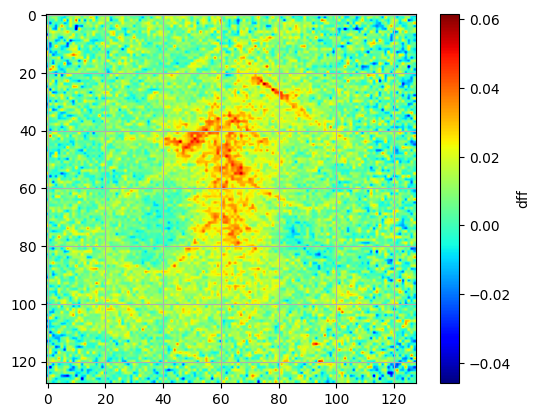

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:47,  2.68it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:42,  2.95it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:37,  3.34it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:36,  3.44it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:34,  3.52it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:35,  3.47it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:34,  3.50it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:34,  3.45it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:34,  3.49it/s]

  8%|██████▎                                                                          | 10/128 [00:02<00:35,  3.32it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:35,  3.29it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:36,  3.18it/s]

 10%|████████▏                                                                        | 13/128 [00:03<00:34,  3.32it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:33,  3.38it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:35,  3.21it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:36,  3.03it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:37,  2.94it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:34,  3.14it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:34,  3.17it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:33,  3.20it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:34,  3.14it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:33,  3.16it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:33,  3.13it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:34,  3.06it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:32,  3.13it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:30,  3.29it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:31,  3.25it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:31,  3.17it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:30,  3.25it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:29,  3.33it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:28,  3.38it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:29,  3.21it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:29,  3.25it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:29,  3.23it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:27,  3.37it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:26,  3.53it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:25,  3.59it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:24,  3.65it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:11<00:25,  3.53it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:26,  3.31it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:26,  3.29it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:12<00:26,  3.23it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:25,  3.29it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:25,  3.33it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:25,  3.32it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:24,  3.33it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:23,  3.42it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:24,  3.29it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:14<00:23,  3.35it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:23,  3.37it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:23,  3.26it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:15<00:23,  3.29it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:21,  3.41it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:21,  3.43it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:16<00:22,  3.29it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:22,  3.27it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:22,  3.18it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:17<00:21,  3.31it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:17<00:20,  3.42it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:19,  3.41it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:19,  3.39it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:18<00:20,  3.30it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:19,  3.35it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:20,  3.16it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:19<00:18,  3.32it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:18,  3.31it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:18,  3.24it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:20<00:18,  3.20it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:20<00:17,  3.29it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:16,  3.42it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:15,  3.58it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:21<00:17,  3.17it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:17,  3.22it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:16,  3.20it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:22<00:15,  3.33it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:15,  3.41it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:14,  3.50it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:23<00:14,  3.53it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:23<00:14,  3.46it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:14,  3.32it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:24<00:13,  3.47it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:24<00:13,  3.44it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:12,  3.52it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:12,  3.46it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:25<00:12,  3.35it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:25<00:11,  3.53it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:11,  3.58it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:26<00:11,  3.41it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:26<00:10,  3.55it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:10,  3.63it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:27<00:10,  3.53it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:27<00:10,  3.45it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:27<00:10,  3.44it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:28<00:09,  3.53it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:28<00:09,  3.58it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:28<00:09,  3.54it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:28<00:08,  3.68it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:29<00:07,  3.76it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:29<00:08,  3.51it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:29<00:08,  3.45it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:30<00:08,  3.32it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:30<00:07,  3.26it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:30<00:07,  3.22it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:31<00:07,  3.16it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:31<00:07,  3.20it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:31<00:06,  3.30it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:32<00:06,  3.28it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:32<00:05,  3.42it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:32<00:05,  3.43it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:32<00:05,  3.20it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:33<00:05,  3.23it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:33<00:05,  3.01it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:33<00:04,  3.23it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:34<00:04,  3.41it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:34<00:03,  3.40it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:34<00:03,  3.46it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:35<00:03,  3.40it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:35<00:03,  3.33it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:35<00:02,  3.36it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:36<00:02,  3.17it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:36<00:02,  3.29it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:36<00:01,  3.25it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:36<00:01,  3.14it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:37<00:01,  3.24it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:37<00:00,  3.31it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:37<00:00,  3.41it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:38<00:00,  3.33it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.35it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:38<00:00,  3.33it/s]

frame number 200 plotted


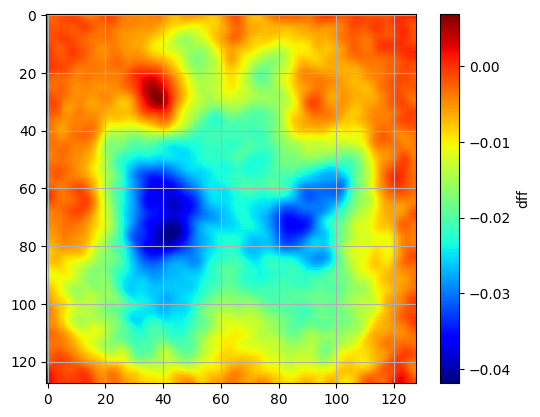

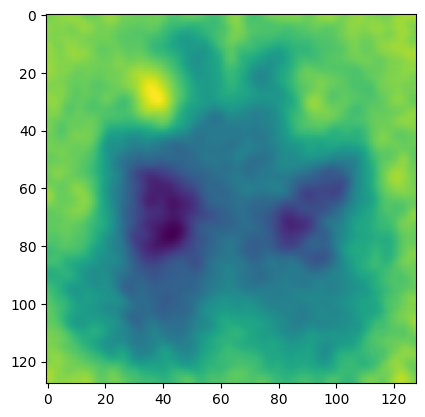

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 15


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 23
fail = 18
total trials = 41


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 26
fail = 18
total trials = 44


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 6
fail = 9
total trials = 15


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34653 [00:00<?, ?it/s]

  8%|█████▊                                                                    | 2746/34653 [00:00<00:01, 27197.22it/s]

 16%|███████████▋                                                              | 5466/34653 [00:00<00:01, 25986.35it/s]

 24%|█████████████████▌                                                        | 8205/34653 [00:00<00:00, 26496.33it/s]

 31%|██████████████████████▊                                                  | 10858/34653 [00:00<00:00, 25429.67it/s]

 40%|█████████████████████████████▏                                           | 13843/34653 [00:00<00:00, 26872.31it/s]

 48%|██████████████████████████████████▊                                      | 16540/34653 [00:00<00:00, 26818.94it/s]

 55%|████████████████████████████████████████▌                                | 19228/34653 [00:00<00:00, 25379.76it/s]

 63%|█████████████████████████████████████████████▉                           | 21782/34653 [00:00<00:00, 25202.48it/s]

 71%|███████████████████████████████████████████████████▋                     | 24525/34653 [00:00<00:00, 25794.78it/s]

 78%|█████████████████████████████████████████████████████████                | 27114/34653 [00:01<00:00, 25296.56it/s]

 86%|██████████████████████████████████████████████████████████████▍          | 29651/34653 [00:01<00:00, 23453.20it/s]

 93%|███████████████████████████████████████████████████████████████████▊     | 32220/34653 [00:01<00:00, 24026.39it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34653/34653 [00:01<00:00, 25137.49it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25009.27it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25007.77it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")